## To-do Functions:
- Read sto file.     x
- Read a directory with sto files     x
- Extract sequence and head.    x
- recognize different types of information from the file.     x
- Make graph.    x
- Create new text file and write seqs and the different relations into it.  x
- Create graphs with different type of information (user entry).    x
- Create target file. x
- 

In [1]:
%matplotlib inline
import os, sys
import subprocess as sp
from itertools import cycle
import networkx as nx
import re
import ntpath
import shutil
import fnmatch
from eden.util import display

read a Sto file separate the extract the interesting information from the file

it takes the file path and returns the head which is the information type and it's sequence

In [2]:
def _readStoFile(file_path =None):
    head_mark0 = '#'
    head_mark1 = '='
    head_mark2 = 'G'
    head_mark3 = 'C'
    head_list = []
    sequence_list = []  
    
    read_file = open(file_path ,'r') 
    for line in read_file: 
        lines = list(line)
            # the read line is the head of the sequence write it in head list
        if lines[0] == head_mark0 and lines[1] == head_mark1 and lines[2] == head_mark2 and lines[3] == head_mark3:
            line = line.strip('#=GC ')            
            line = line.strip('\n')
            line = line.split(' ')
            line = filter(None, line)

            head = line[0]
            head_list.append(head)
            sequence = line[1].split()
            sequence_list.append(sequence)
            zip_head_seqs = zip(head_list, sequence_list)
      
    return zip_head_seqs

recognize the different types of information extracted from step1
it takes the zipped info from the funtion '_readStoFile' and returns a dictionary 
    that identify every type of information

In [3]:
def _identifyInformationType(file_name, head_seq_list):

    secondery_structure_s = []
    conservation_s = []
    conservation_stringth_s = []
    entropy_0_s = []
    entropy_1_s = []
    entropy_2_s = []
    entropy_3_s = []
    coveriation_s = []

    for i, elemant in enumerate(head_seq_list):
        info_item = head_seq_list[i]
        
        if info_item[0] == 'SS_cons':
            secondery_structure_s.append(str(info_item[1]))
            
        if info_item[0] == 'cons':
            conservation_s.append(str(info_item[1]))
            
        if info_item[0] == 'conss':
            conservation_stringth_s.append(info_item[1])
            
        if info_item[0] == 'col_entropy_0':
            entropy_0_s.append(info_item[1])
            
        if info_item[0] == 'col_entropy_1':
            entropy_1_s.append(info_item[1])

        if info_item[0] == 'col_entropy_2':
            entropy_2_s.append(info_item[1])
            
        if info_item[0] == 'col_entropy_3':
            entropy_3_s.append(info_item[1])   
            
        if info_item[0] == 'cov_SS_cons':
            coveriation_s.append(info_item[1])
            
    file_dictionary = {"ID_file name": file_name, "conservation": conservation_s, "secondery_structure": secondery_structure_s,
                       "conservation_stringth": conservation_stringth_s, "entropy_3": entropy_3_s, "covariation": coveriation_s}
    return file_dictionary

In [4]:
def _filterInfo(info_type):
    sequence = info_type['conservation']
    structure = info_type['secondery_structure']
    conservation_stringth = info_type['conservation_stringth']
    covariation = info_type['covariation']
    entropy_3 = info_type['entropy_3']

    sequence = sequence[0].strip('[\']')
    #print ('seq', sequence)
    structure = structure[0].strip('[\']')
    #print ('stru', structure)
    conservation_stringth = str(conservation_stringth[0]).strip('[\']')
    covariation = str(covariation).strip('[\']')
    entropy_3 = str(entropy_3[0]).strip('[\']')

    zip_info_type = zip(sequence,conservation_stringth,covariation,entropy_3)
    return sequence, structure, conservation_stringth, covariation, entropy_3
    #return zip_info_type, structure

build a Networkx graph with all type of info (the most general graph)

this graph identifies the basepair relation beside the next relation between the nodes

In [5]:

def _buildGraph(head, sequence, structure, conservation_stringth, covariation, entropy_3):
    
    print ("Graph title", head)
    #print zip_all_info
    open_pran = "<" or "(" or "[" or "{"
    close_pran = ">" or ")" or "]" or "}"
    stack_o = []
    stack_pos_o =[]
    stack_c = []
    graph_list = []
    G = nx.Graph()

    #G.graph['sequence']= sequence
    #G.graph['covariation']= covariation

    for i, k in enumerate(structure):
        
        #node labeled with all info
        seqCovConssEnt = sequence[i] + covariation[i] + conservation_stringth[i] + entropy_3[i]
        G.add_node(i, label = seqCovConssEnt)
        
        # connect with the next node 
        if i > 0:
            G.add_edge(i-1, i, label= 'x')
           
        """find basepair and connect them"""
        if structure[i] == open_pran:
            j = i
            stack_o.append(structure[j])
            stack_pos_o.append(j)
            open_len = len(stack_o)

        if structure[i] == close_pran:
            stack_c.append(structure[i])
            stack_o.pop()
            j = stack_pos_o.pop()
            G.add_edge(i, j, label = 'b')
    graph_list += [G.copy()]
    #print graph_list

    return graph_list 

transform the general graph to the wanted graph based on parameters passed by the '_graphParametersList' function

In [6]:
'''Recognize basepairs and include them to the generated graph'''

def _buildParameterizedGraph(head, graph_params, structure):
    
    print ("Graph title", head)
    #print zip_all_info
    open_pran = "<" or "(" or "[" or "{"
    close_pran = ">" or ")" or "]" or "}"
    stack_o = []
    stack_pos_o =[]
    stack_c = []
    G = nx.Graph()
    
    params = list(graph_params)
    for i, k in enumerate(structure):
        G.add_node(i, label = params[0])

        if i > 0:
            G.add_edge(i-1, i, label= 'x')

        if structure[i] == open_pran:
            j = i
            stack_o.append(structure[j])
            stack_pos_o.append(j)
            open_len = len(stack_o)

        if structure[i] == close_pran:
            stack_c.append(structure[i])
            stack_o.pop()
            j = stack_pos_o.pop()
            G.add_edge(i, j, label = 'b')
            
    return G

In [7]:
def _transformGraph(G, head, graphParmeter, structure):
    graph_list = []
    for i, param in enumerate(graphParmeter):
        graphs = _buildParameterizedGraph(head, param, structure)
        graph_list += [graphs.copy()]
    return graph_list

In [8]:
def _graphParametersList(sequence, structure, conservation_stringth, covariation, entropy_3):
    
    
    seqCov = zip(sequence, covariation)
    seqCovConss = zip(sequence, covariation, conservation_stringth)        
    seqCovConssEnt = zip(sequence, covariation, entropy_3)        
    covSeq = zip(covariation, sequence)

    param_list = [seqCov, seqCovConss, seqCovConssEnt, covSeq]

    return param_list
        

## Experiments:

### Read one file

read one STO file, extract the desired info, and then build the graph

it takes the STO file path and returns it's graph

In [9]:
def _FileToGraphConvertor(file_path=None):
    head = ntpath.splitext(ntpath.basename(file_path))[0]
    zip_head_seqs = _readStoFile(file_path)
    #print zip_head_seqs
    info_type = _identifyInformationType(head, zip_head_seqs)
    sequence, structure, conservation_stringth, covariation, entropy_3 = _filterInfo(info_type)
    graph_list = _buildGraph(head, sequence, structure, conservation_stringth, covariation, entropy_3)
    for G in graph_list:
        display.draw_graph(G, size=40, node_size=400, font_size=20, node_border=True, prog='neato', title_key= 'head')
        
    params_list = _graphParametersList(sequence, structure, conservation_stringth, covariation, entropy_3)
    transform_graph_list = _transformGraph(G, head, params_list, structure)
    for G in transform_graph_list:
        display.draw_graph(G, size=40, node_size=400, font_size=20, node_border=True, prog='neato', title_key= 'head')
    

('Graph title', '550-53949-1-0')


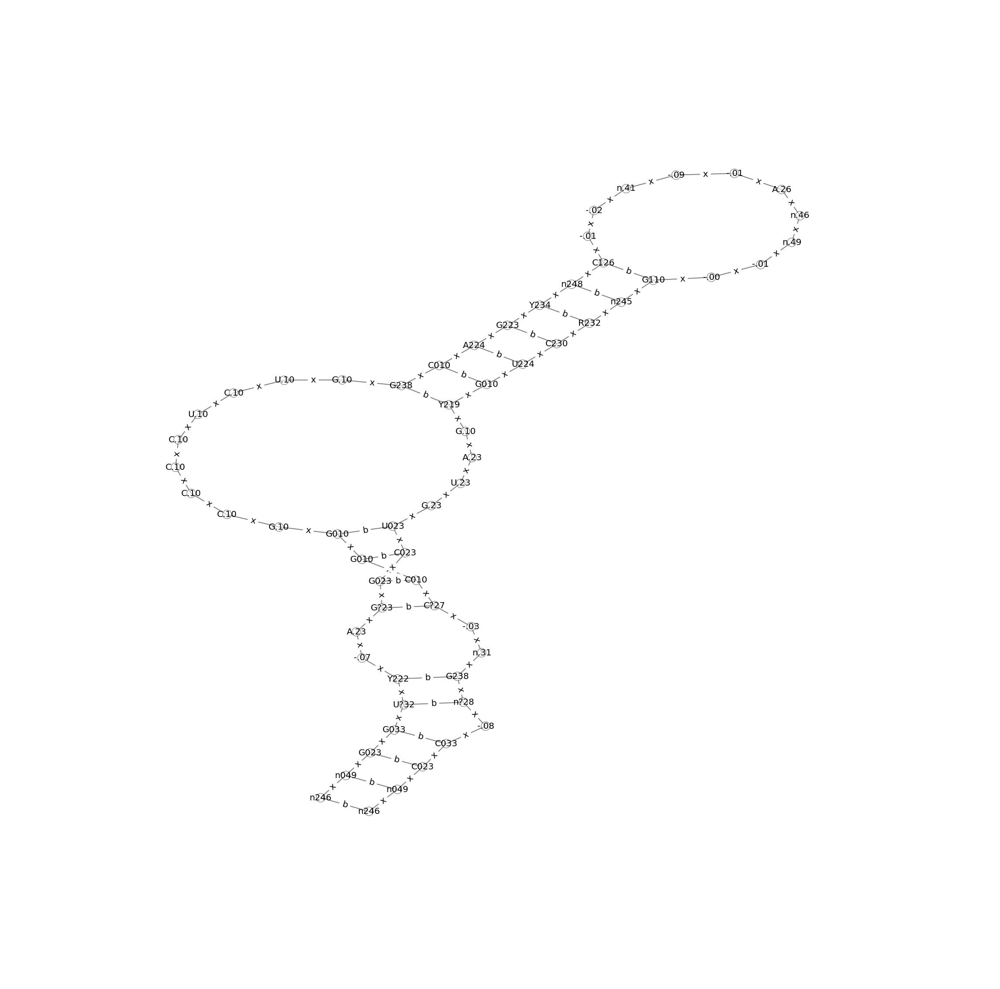

('Graph title', '550-53949-1-0')
('Graph title', '550-53949-1-0')
('Graph title', '550-53949-1-0')
('Graph title', '550-53949-1-0')


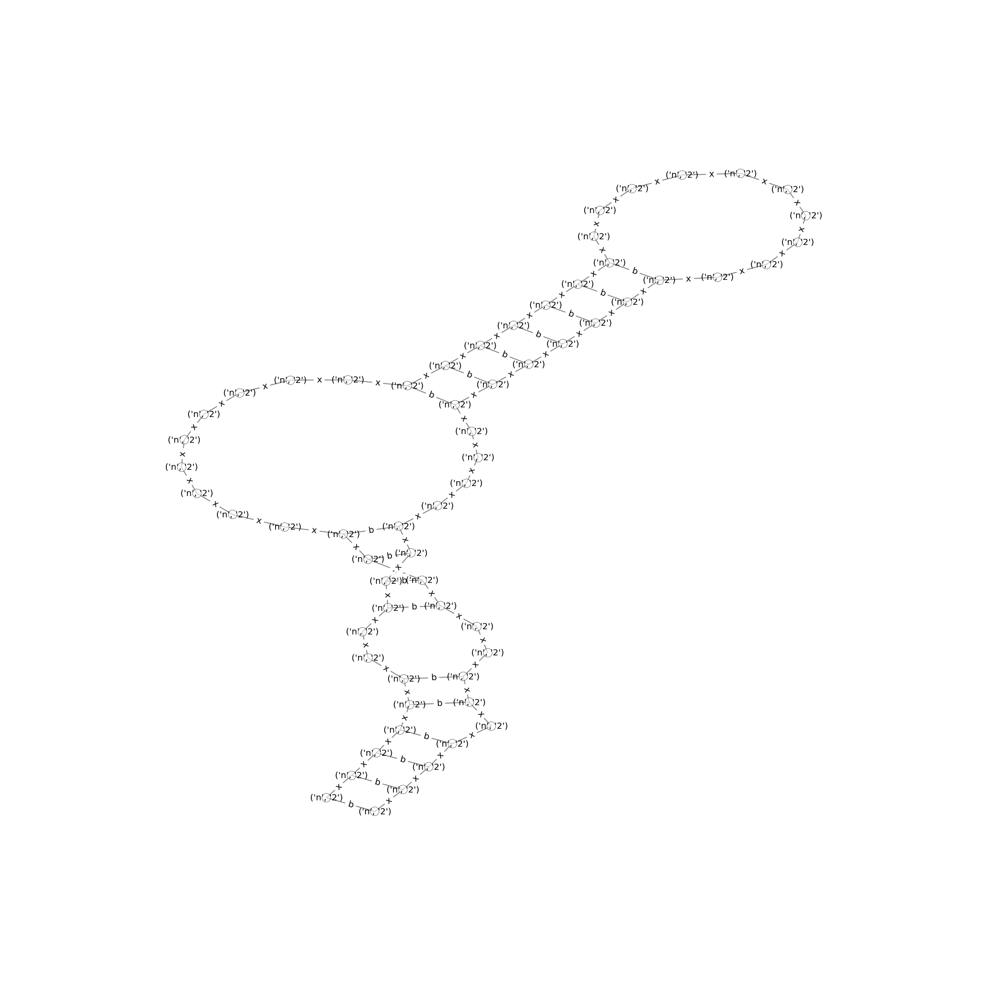

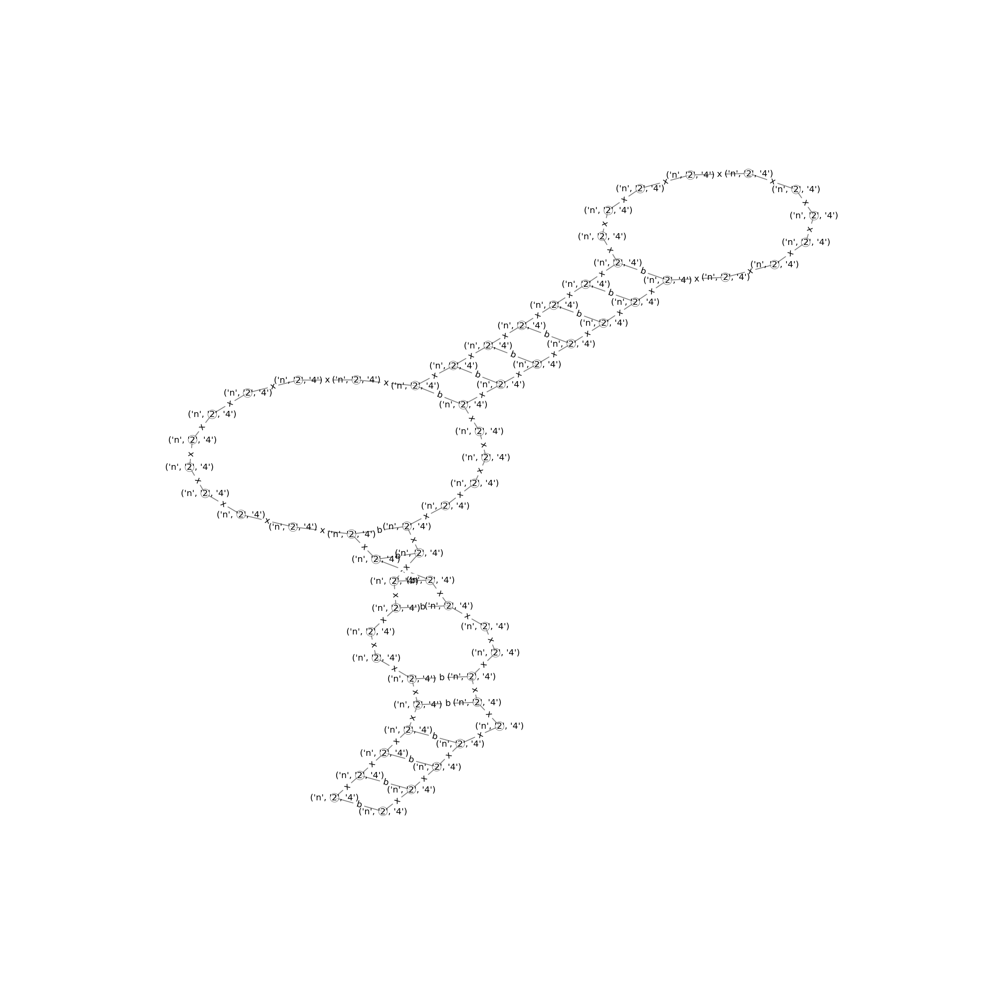

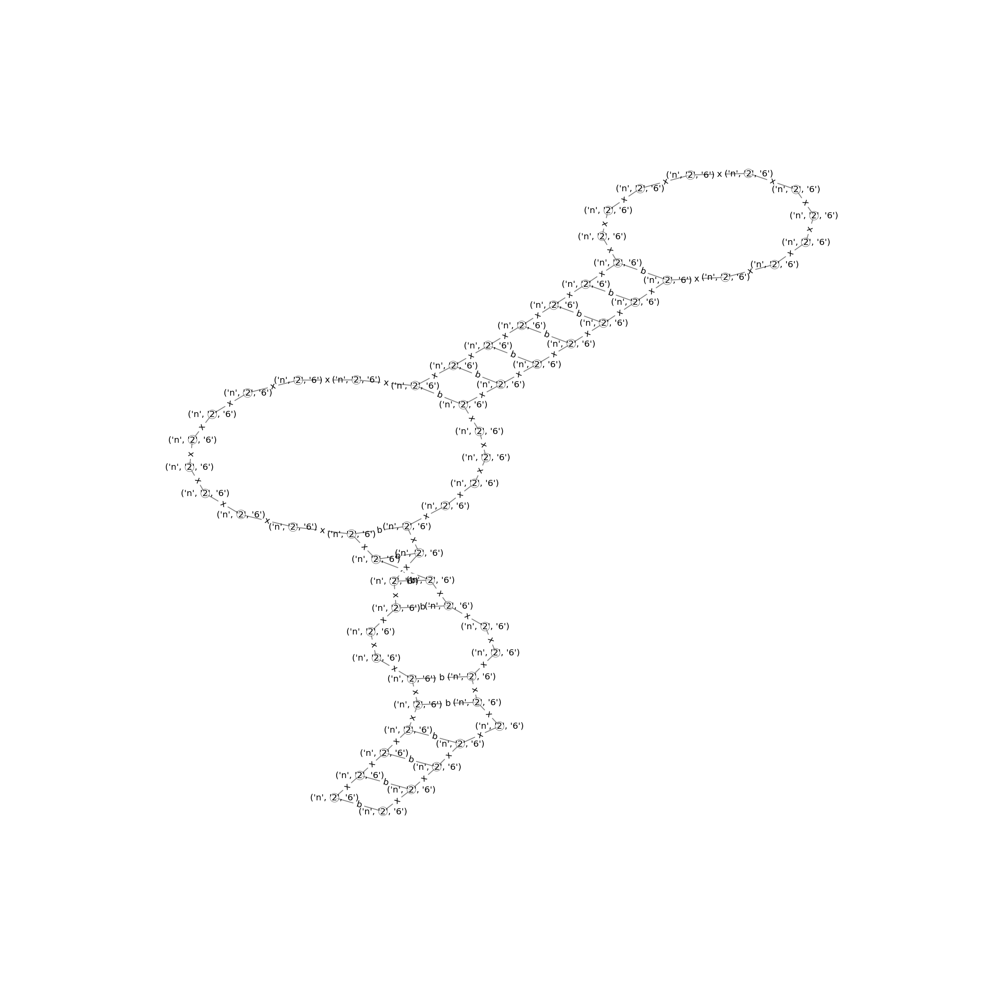

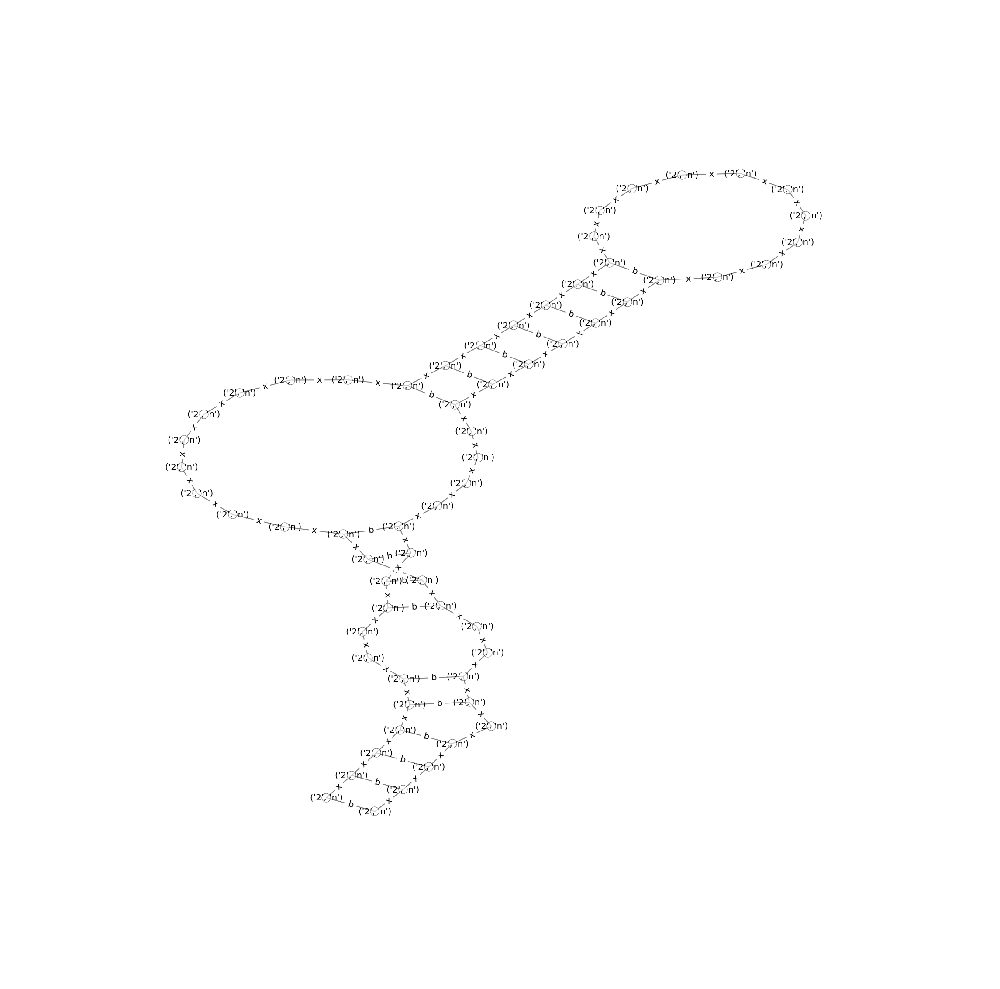

In [10]:
file_path = "/home/alsheikm/GitDir/EeDN_work/StoExamples/StoExmapleSmall/positives-sto/550-53949-1-0.sto"
File_to_Graph = _FileToGraphConvertor(file_path)

### Read a directory

read a folder of STO files and then call '_FileToGraphWrapper' function

it taked the directory path and returns list of their's graphs

In [12]:
def _FolderToGraphConvertor(directory = None):
    for file_name in os.listdir(directory):
        file_complete_path = os.path.join(directory, file_name)
        read_file = _FileToGraphConvertor(file_complete_path)

('Graph title', '550-70730-0-0')


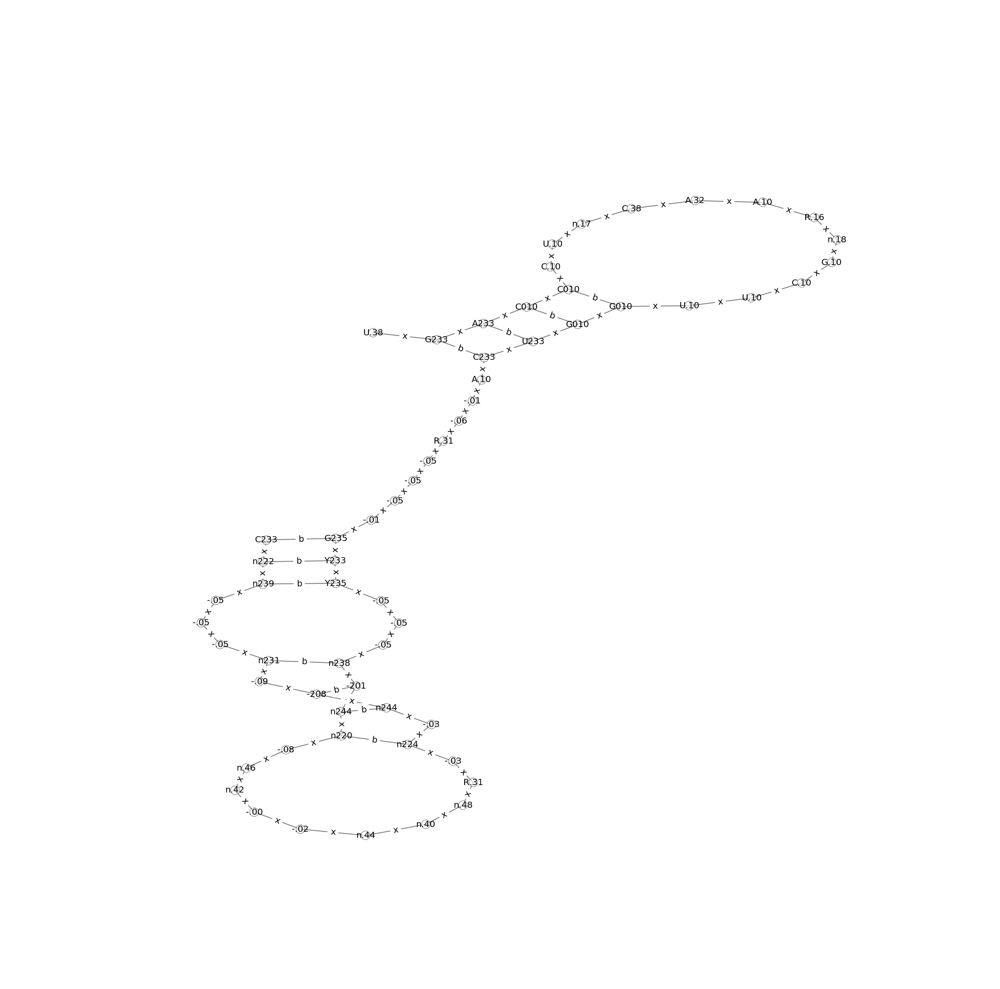

('Graph title', '550-70730-0-0')
('Graph title', '550-70730-0-0')
('Graph title', '550-70730-0-0')
('Graph title', '550-70730-0-0')


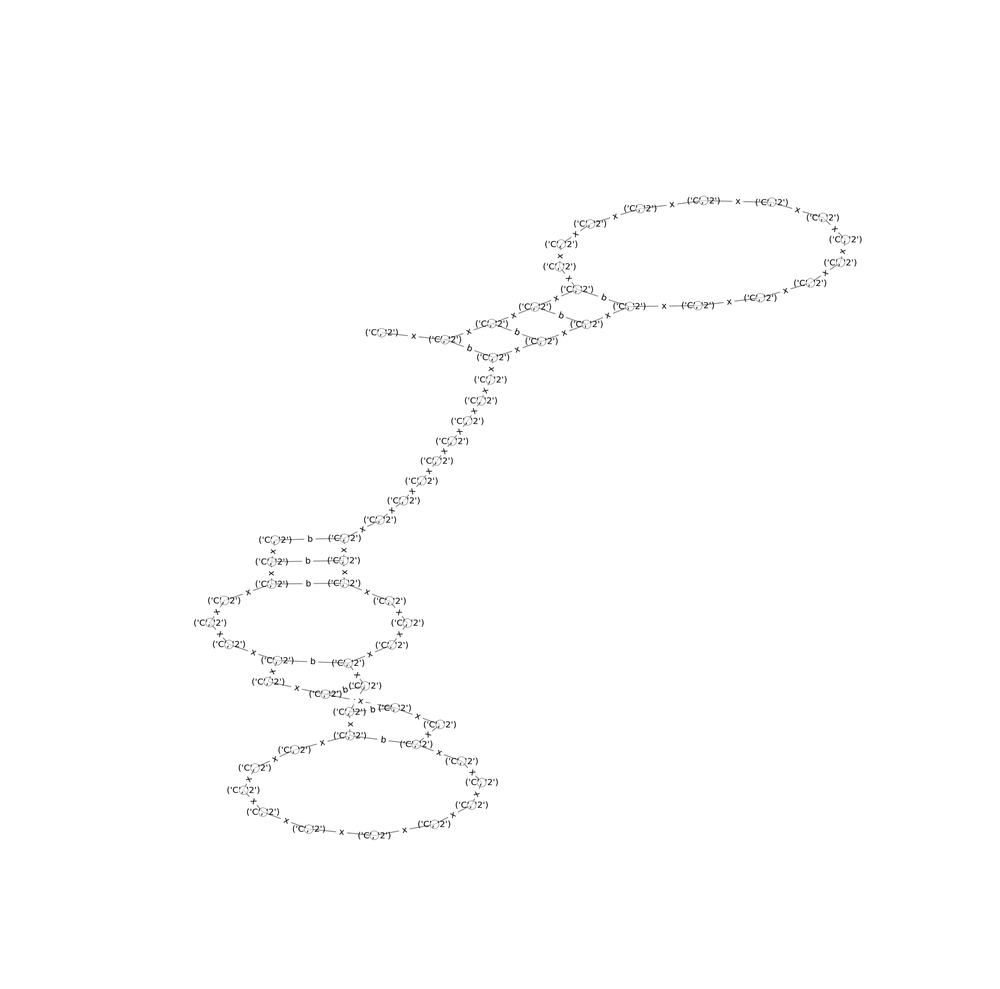

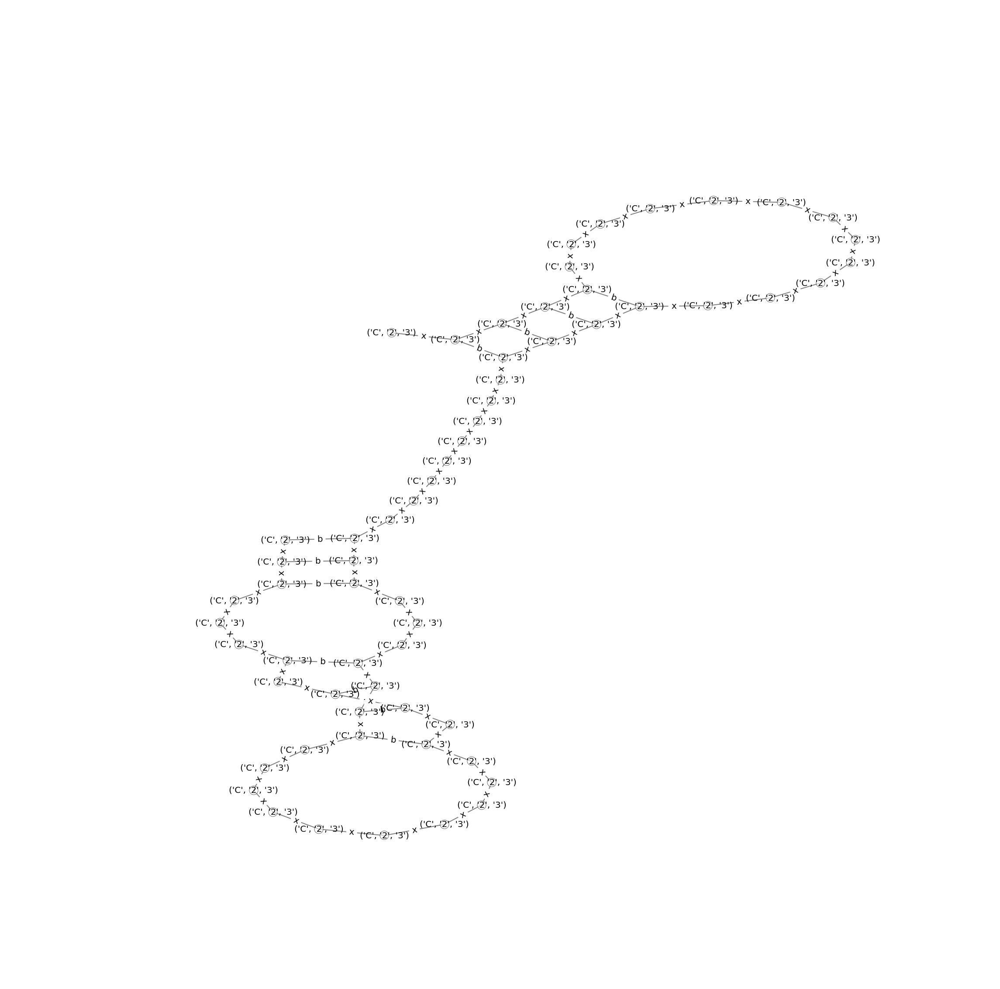

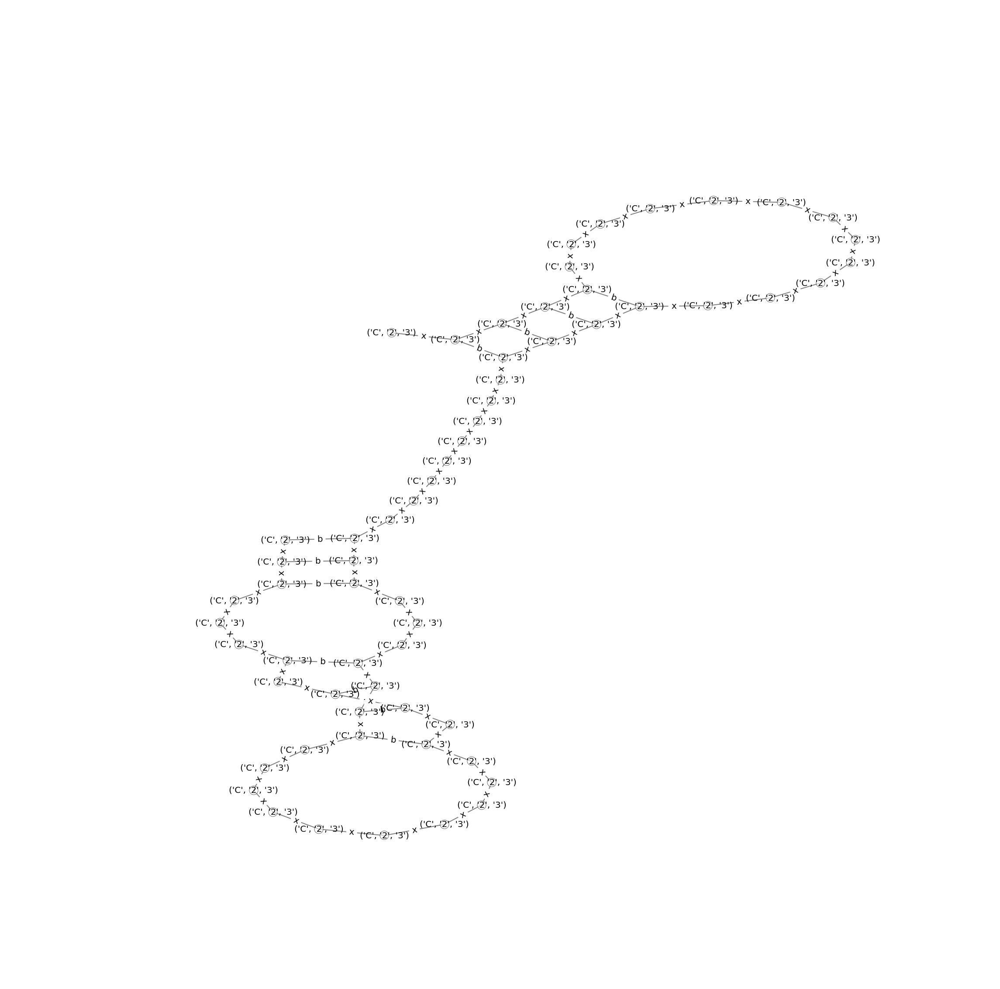

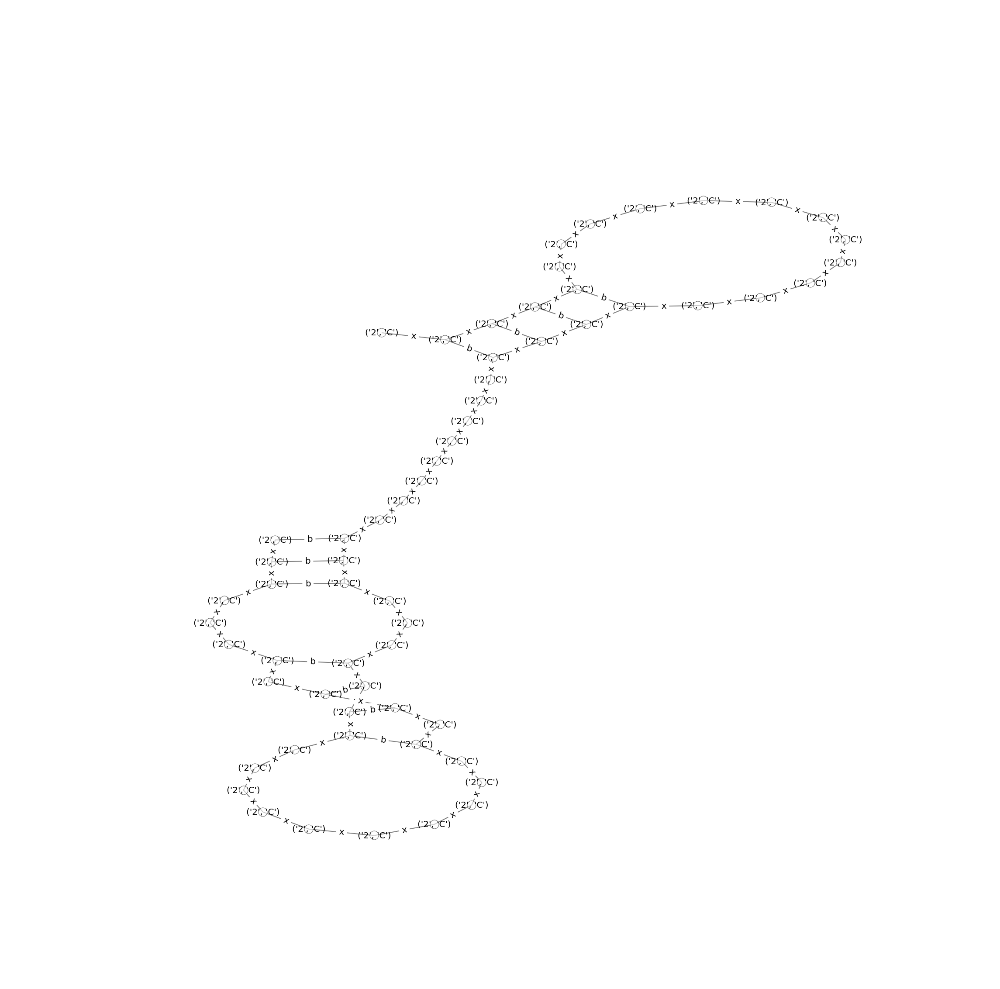

('Graph title', '550-53949-1-0')


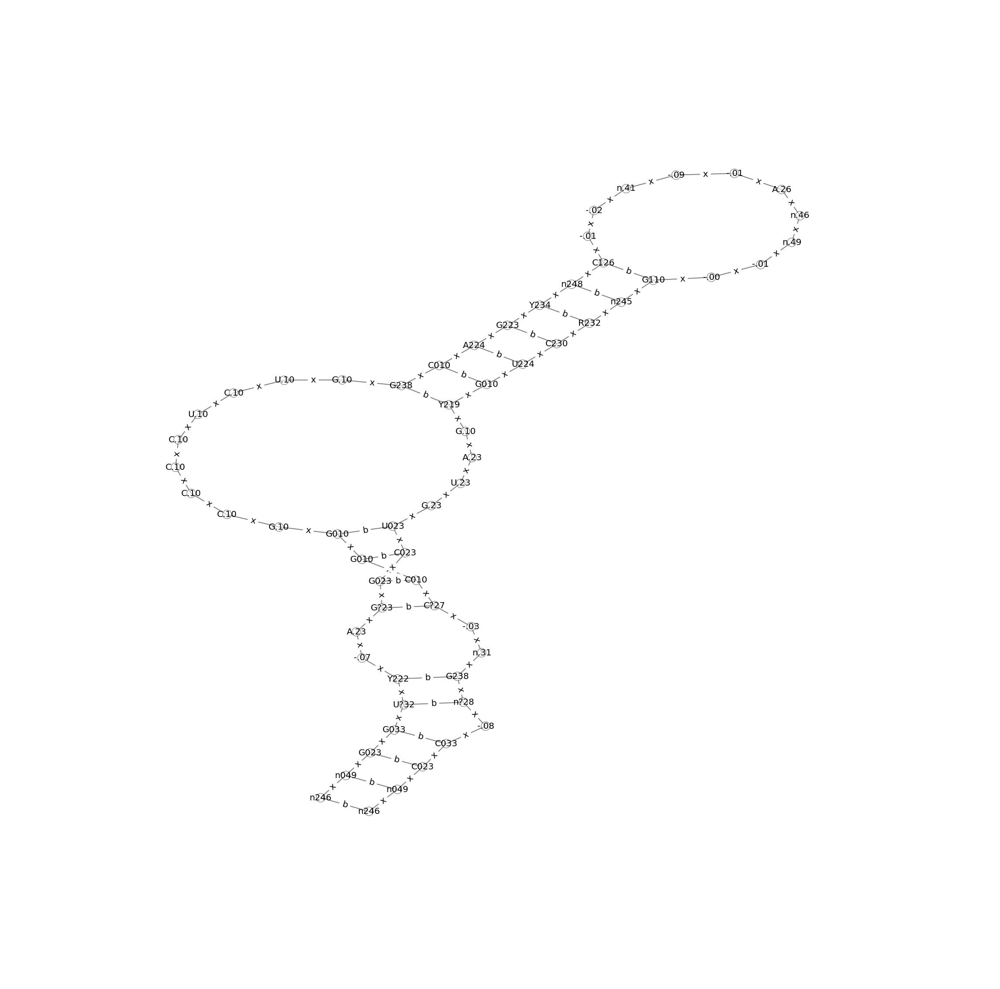

('Graph title', '550-53949-1-0')
('Graph title', '550-53949-1-0')
('Graph title', '550-53949-1-0')
('Graph title', '550-53949-1-0')


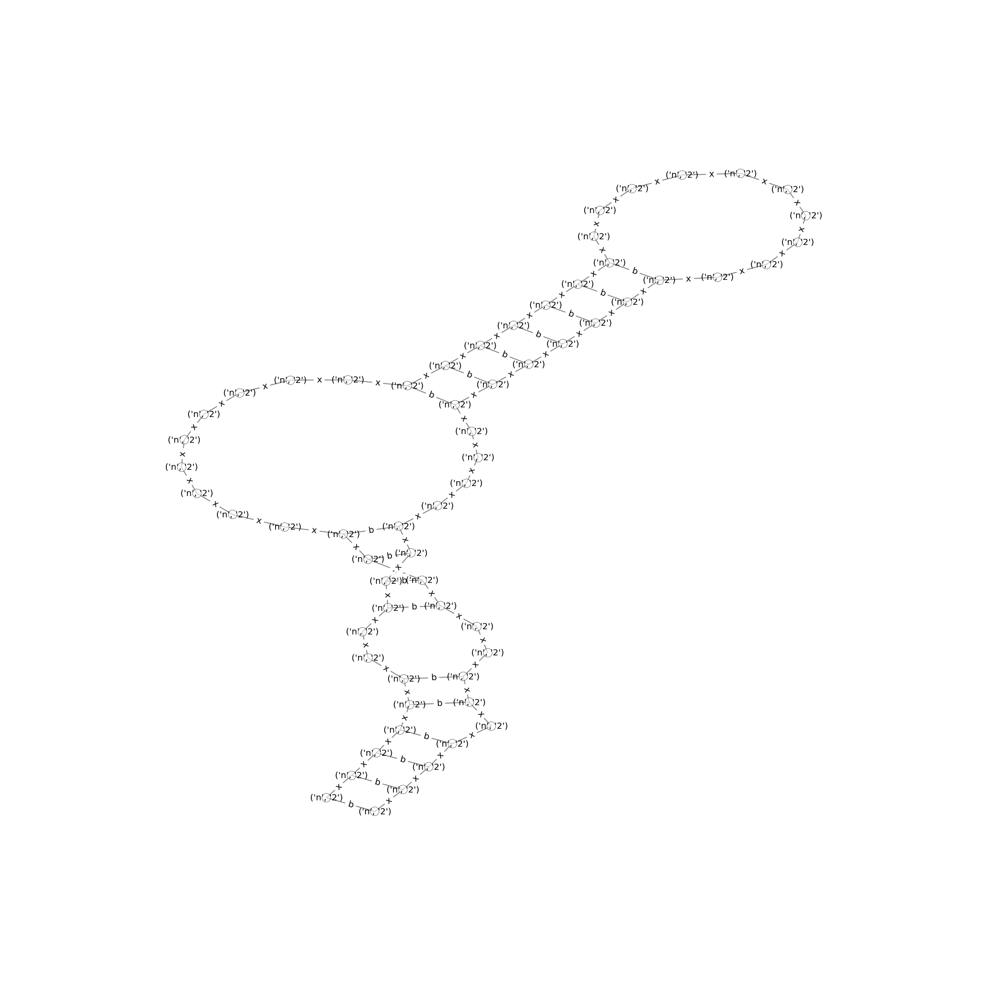

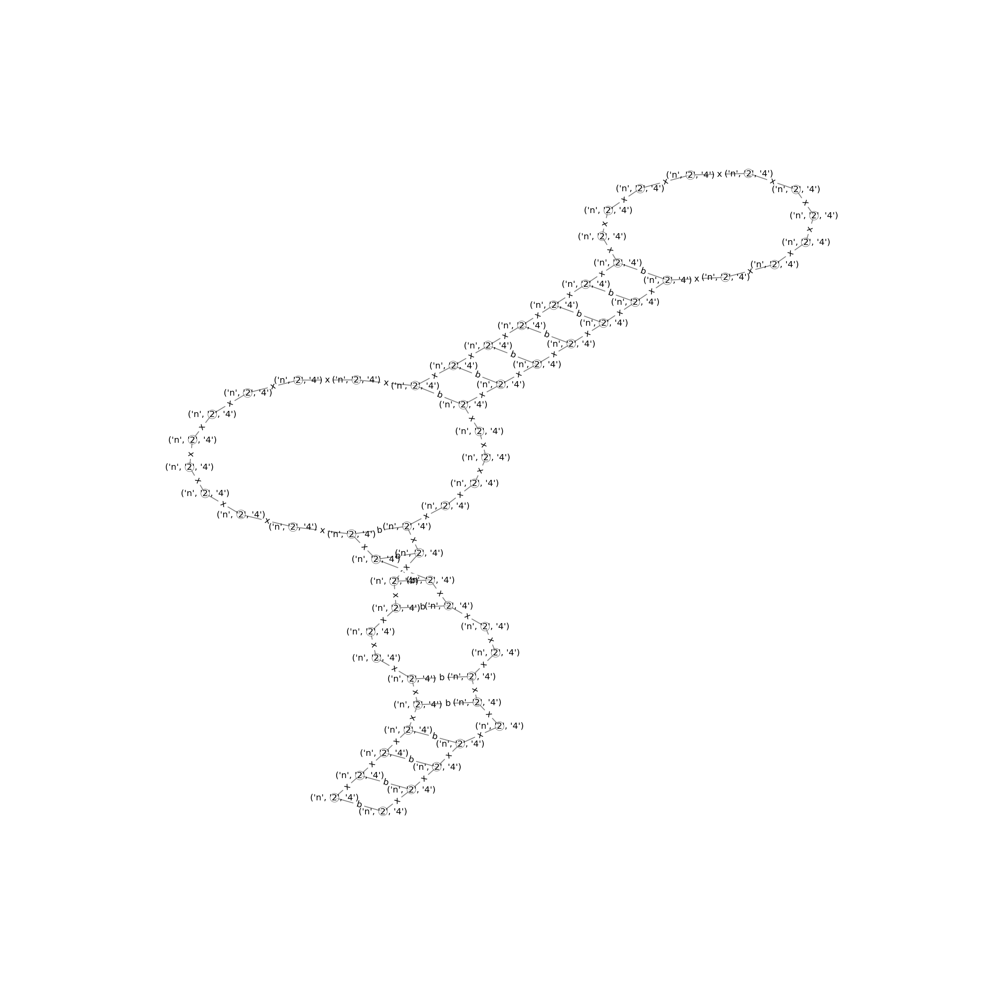

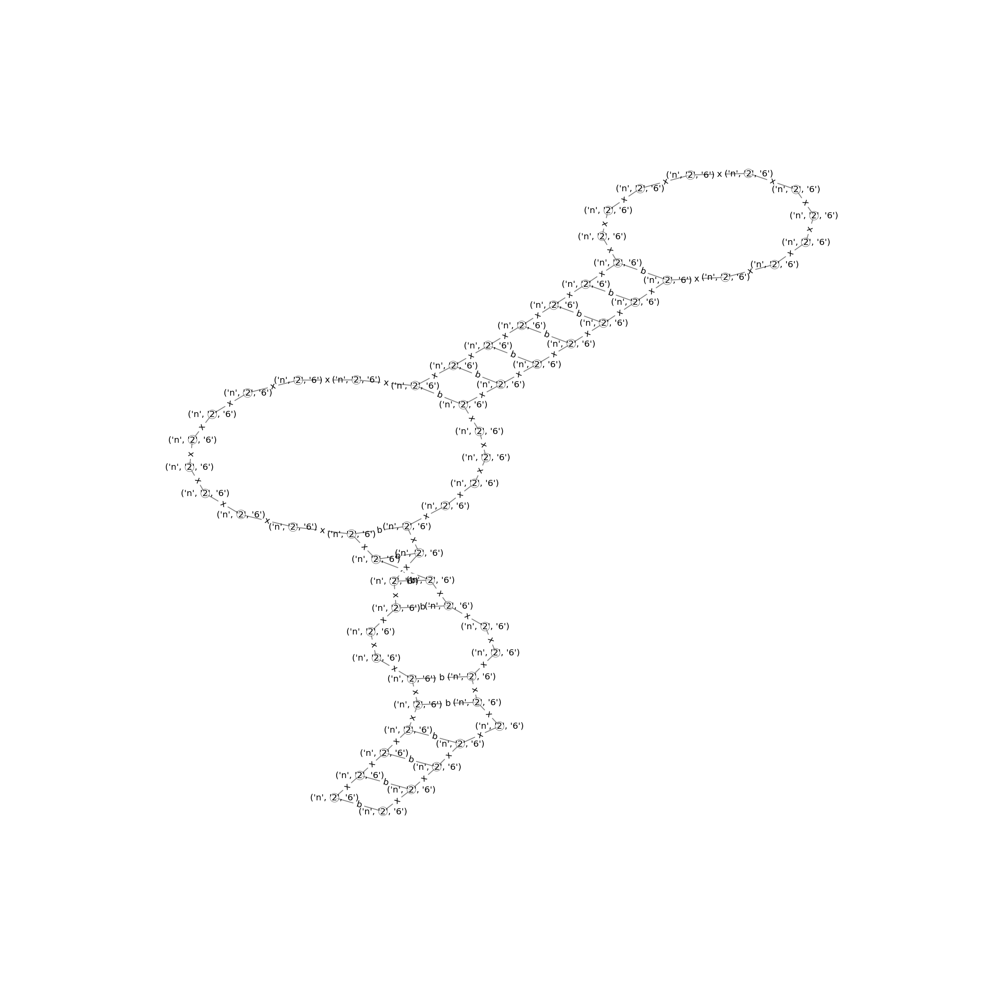

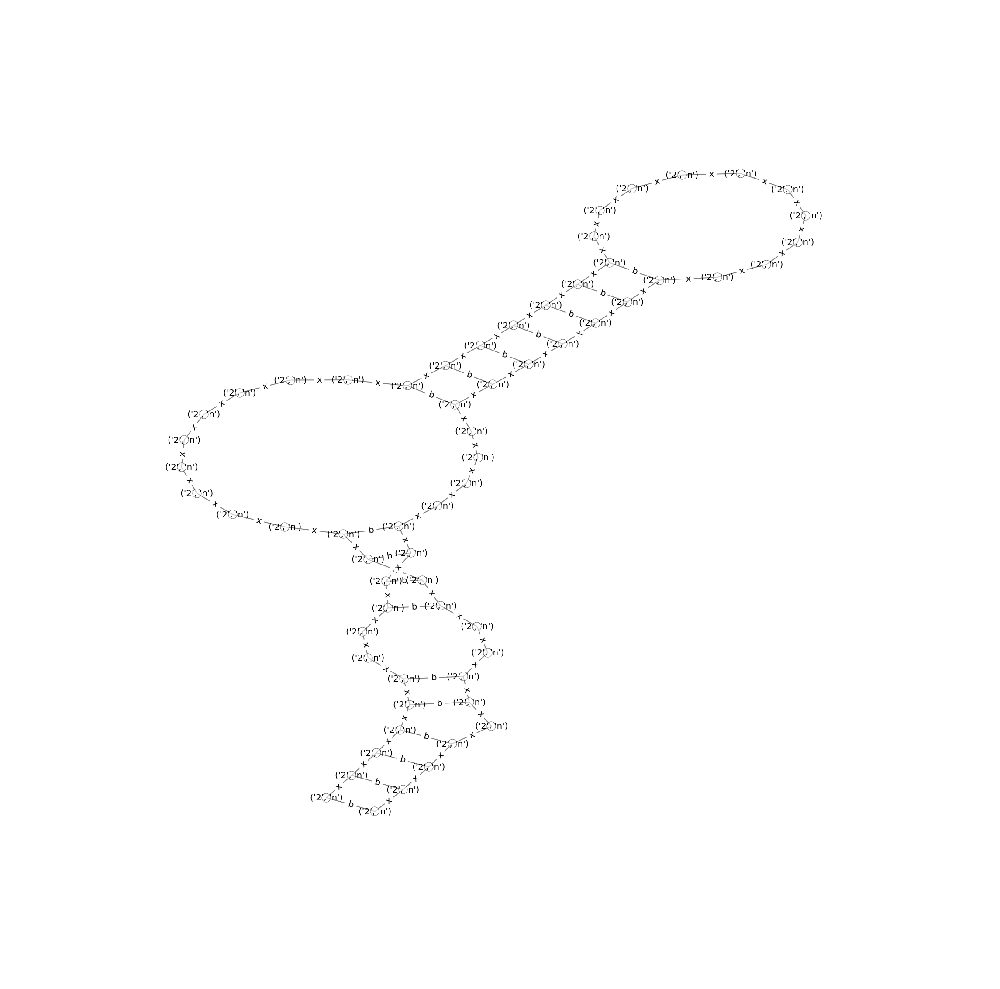

('Graph title', '550-70852-0-0')


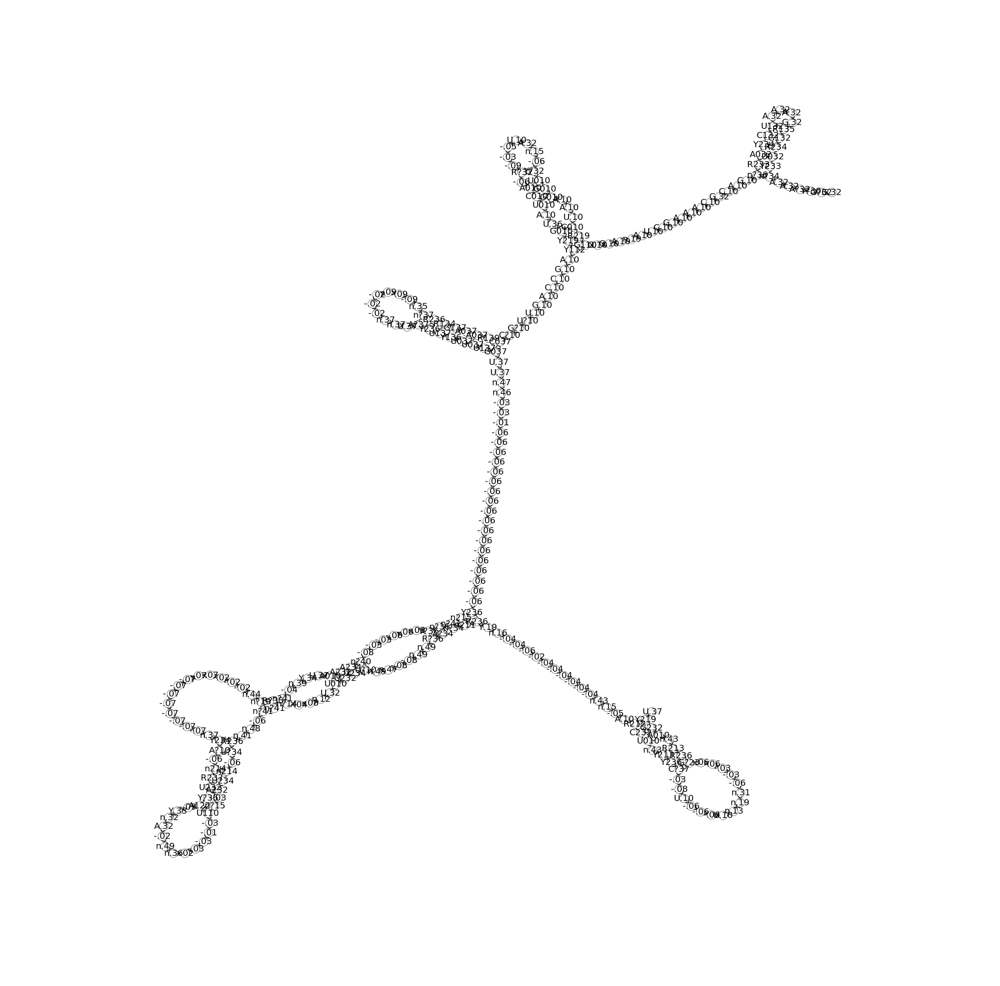

('Graph title', '550-70852-0-0')
('Graph title', '550-70852-0-0')
('Graph title', '550-70852-0-0')
('Graph title', '550-70852-0-0')


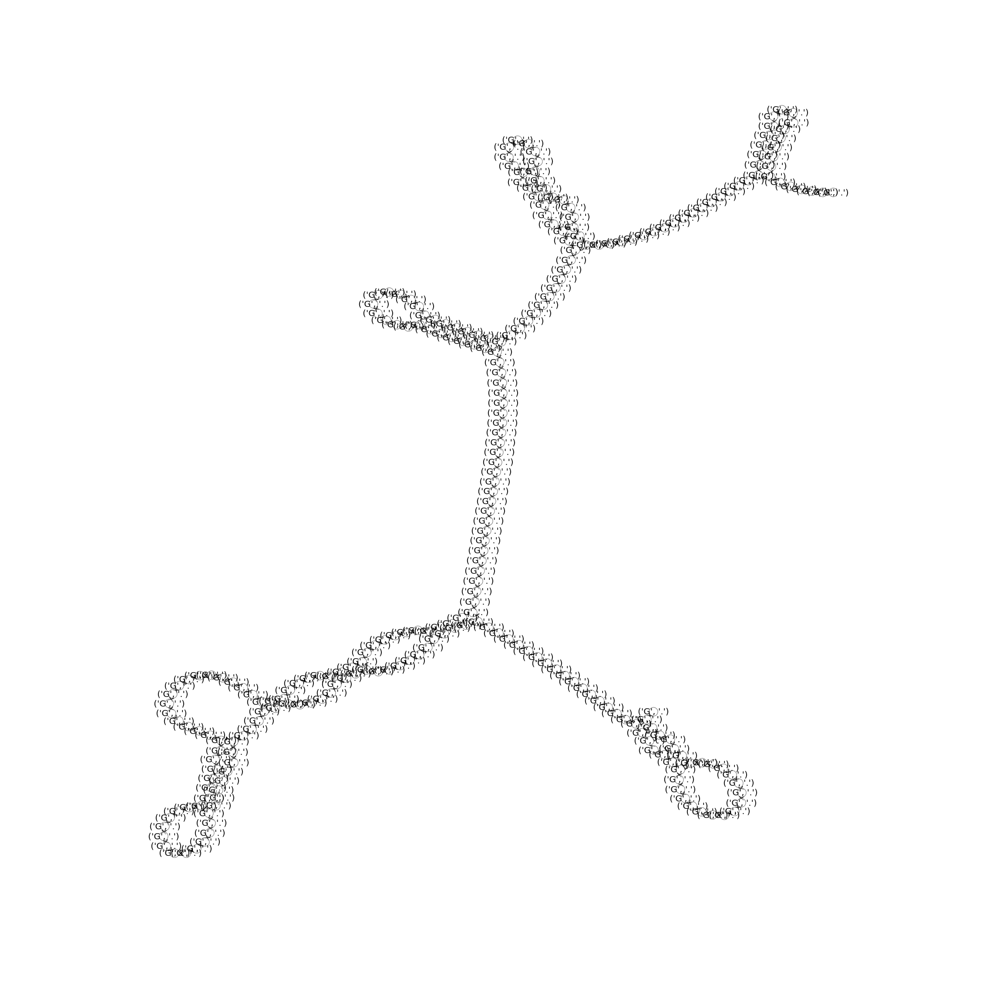

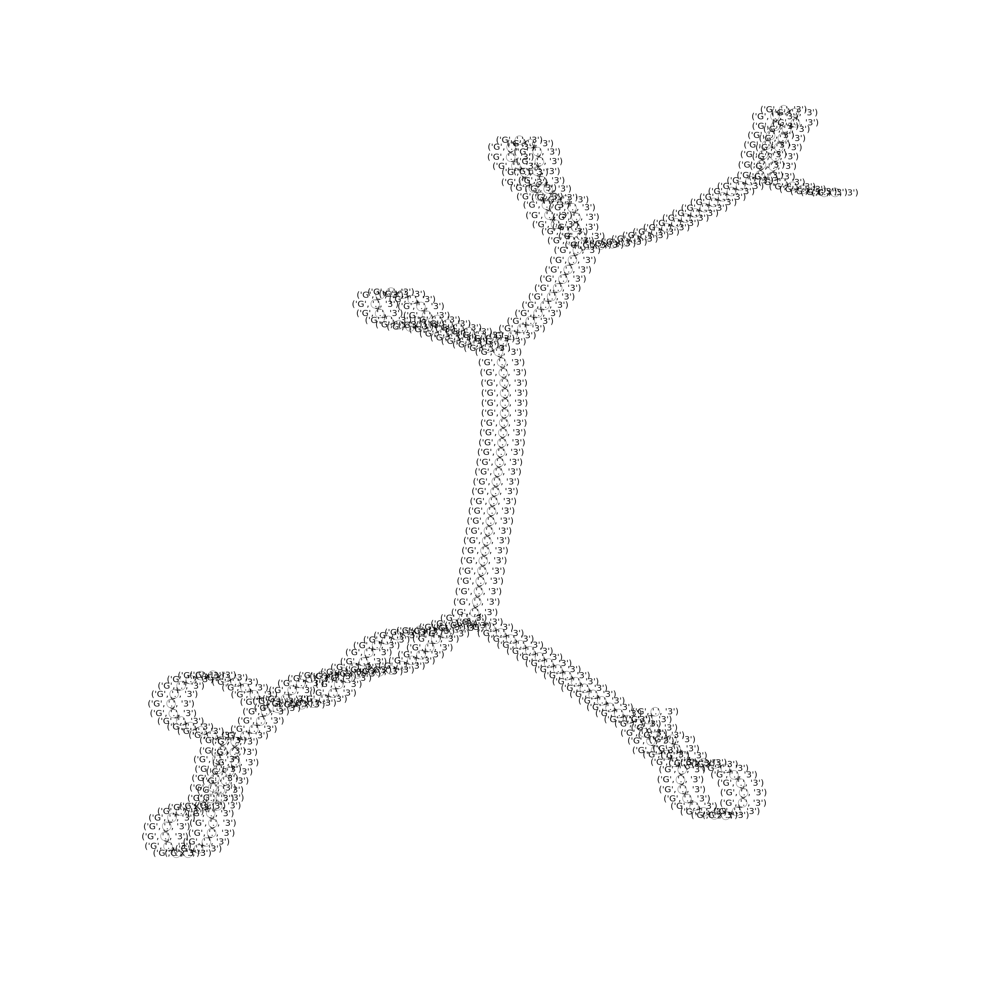

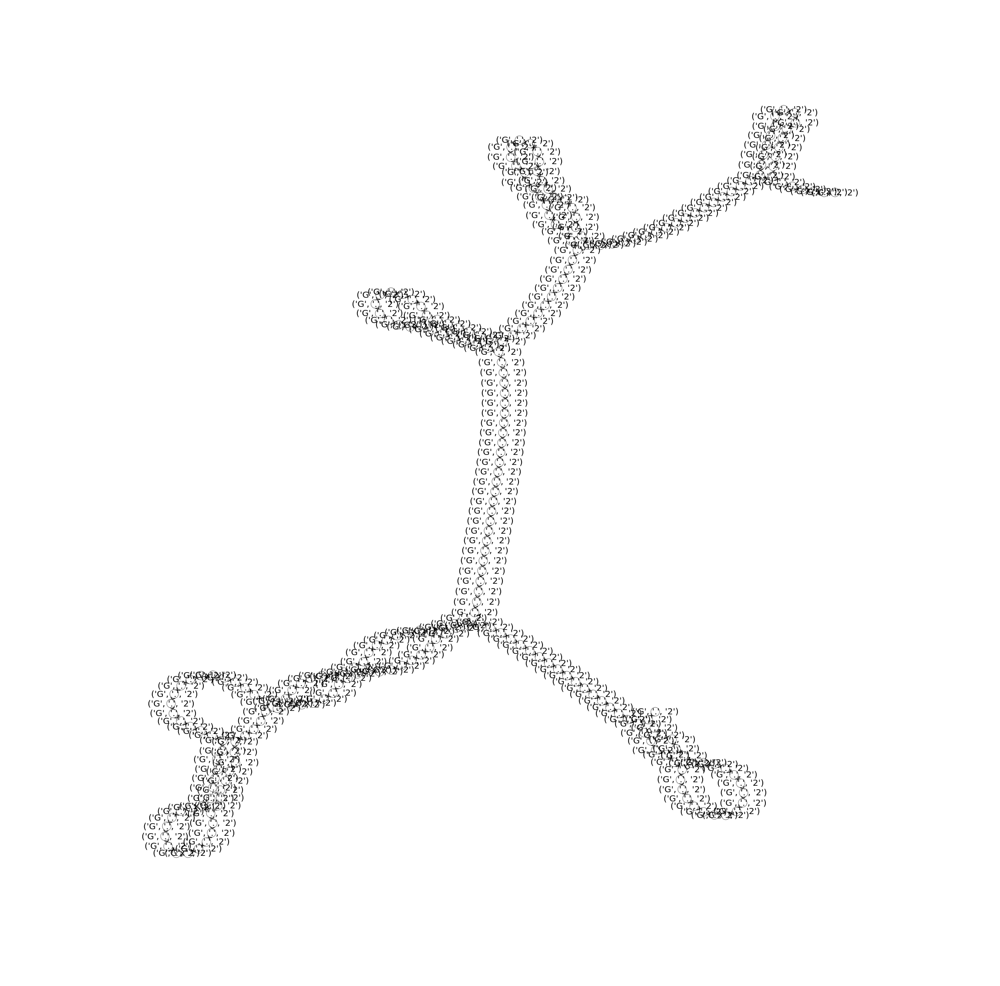

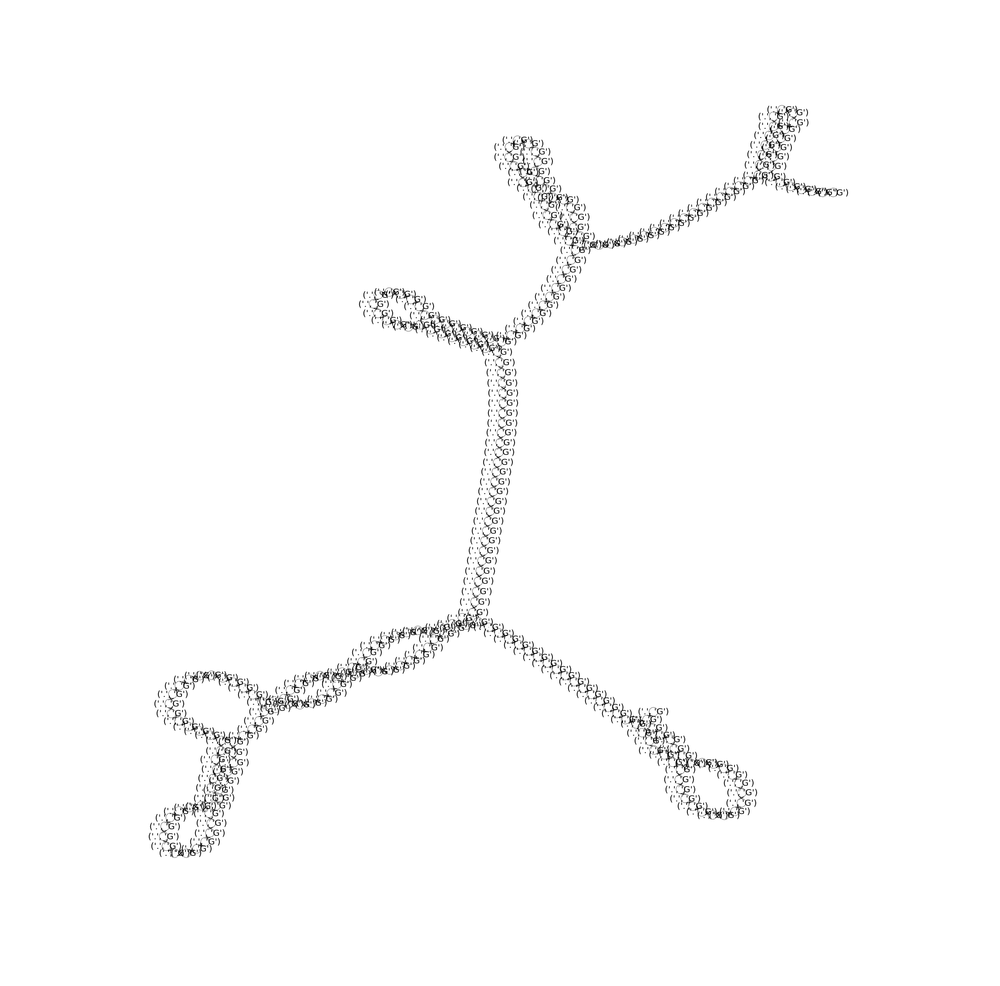

('Graph title', '550-69275-0-0')


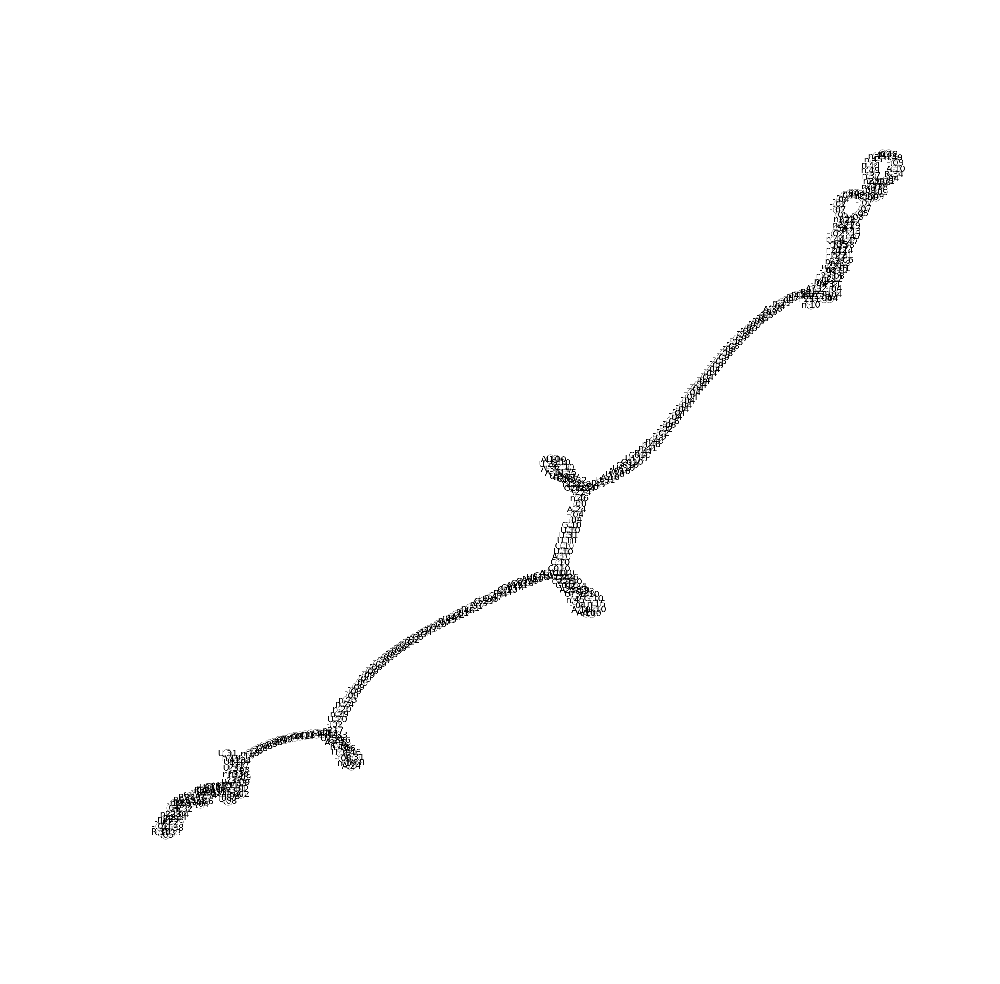

('Graph title', '550-69275-0-0')
('Graph title', '550-69275-0-0')
('Graph title', '550-69275-0-0')
('Graph title', '550-69275-0-0')


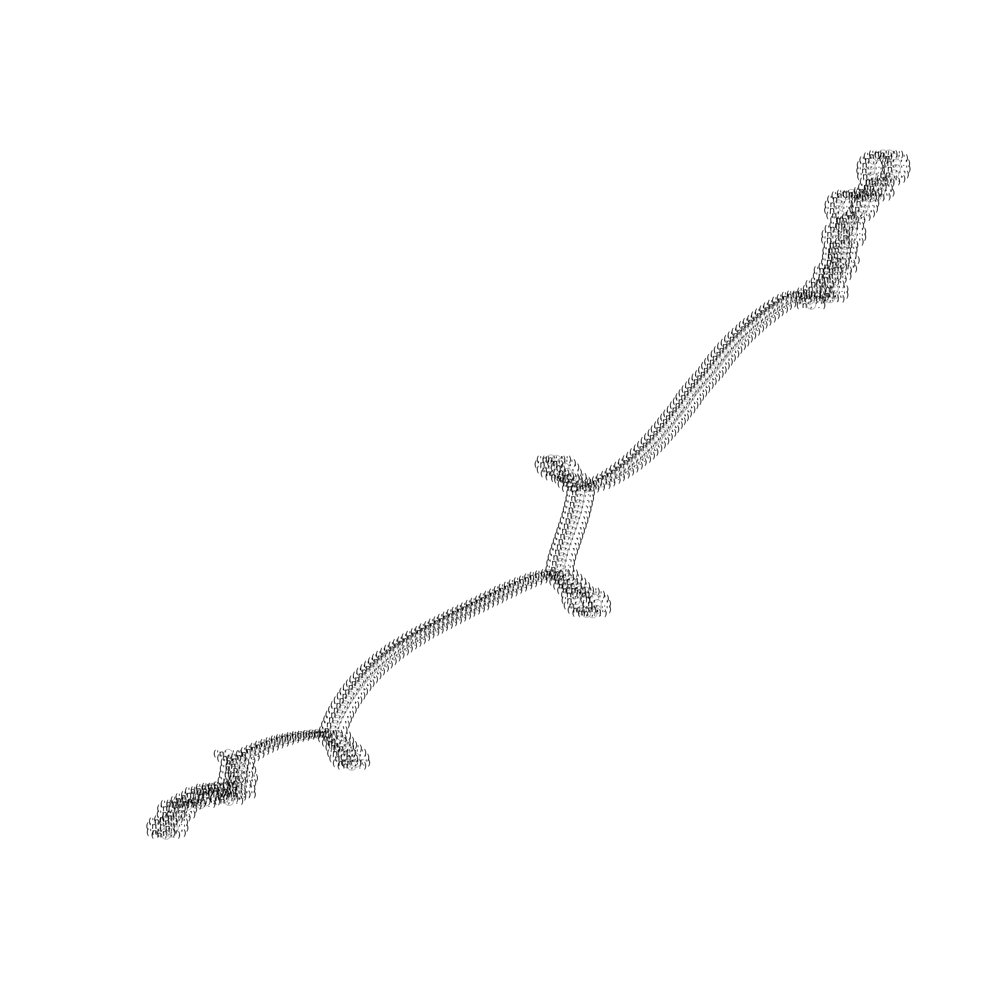

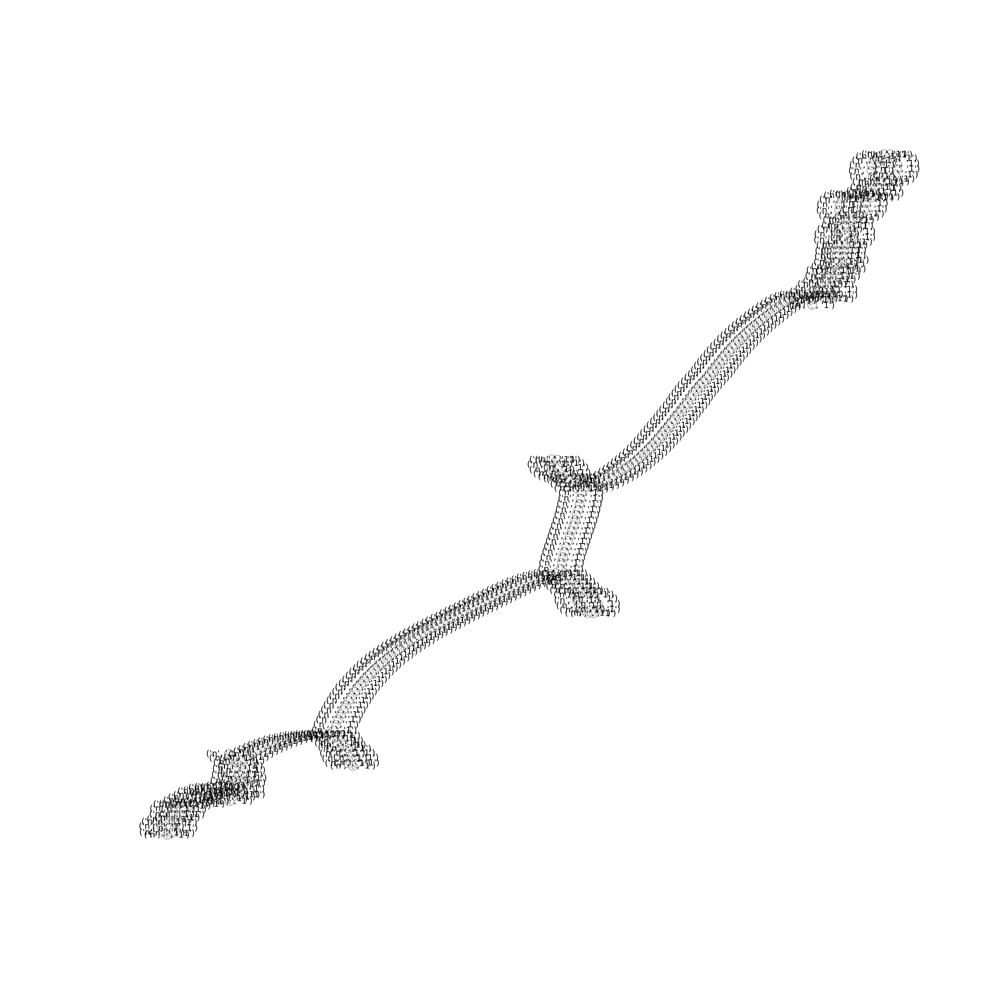

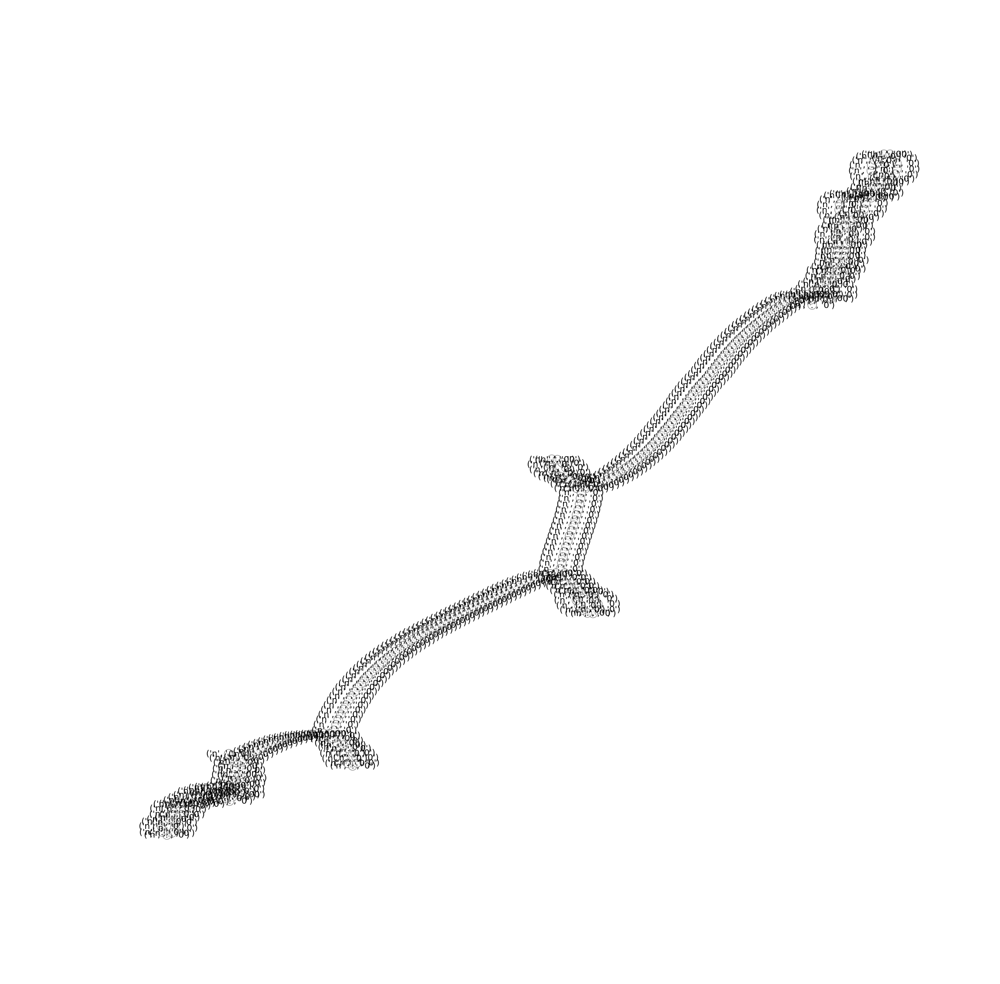

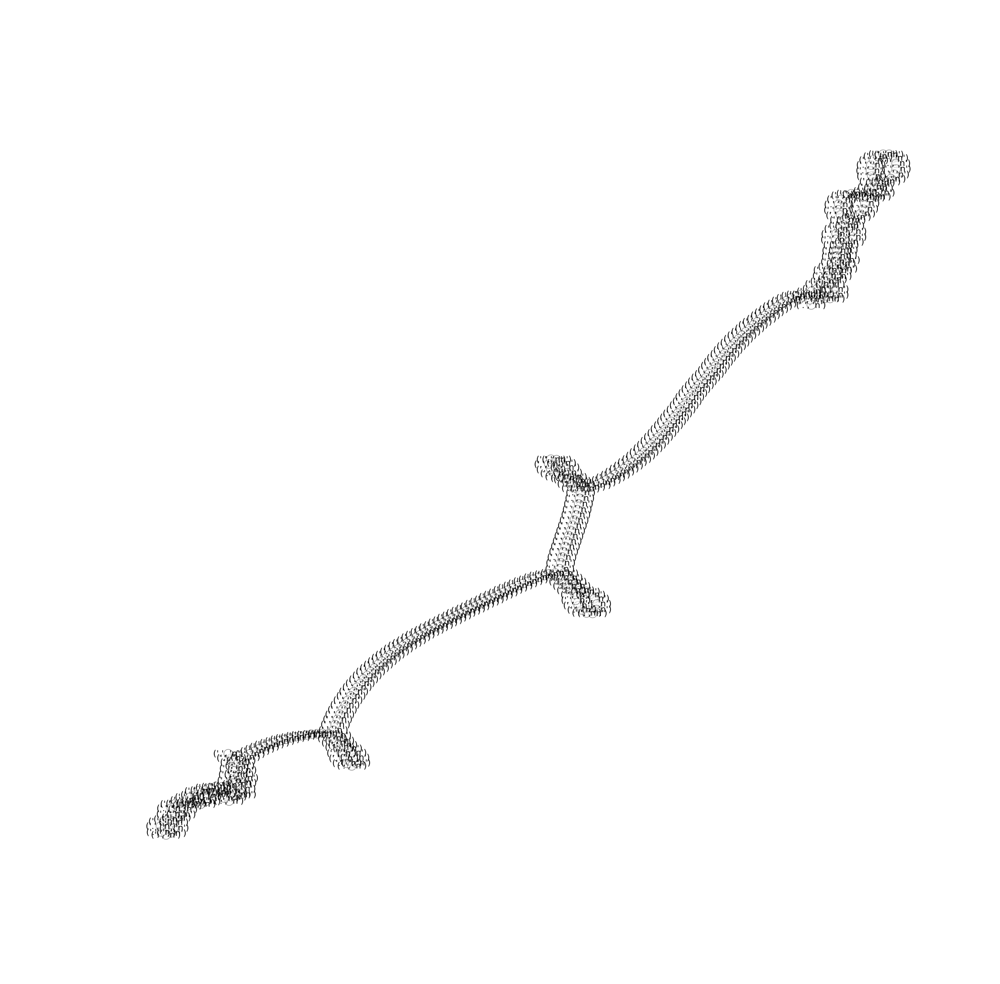

('Graph title', '550-69410-0-0')


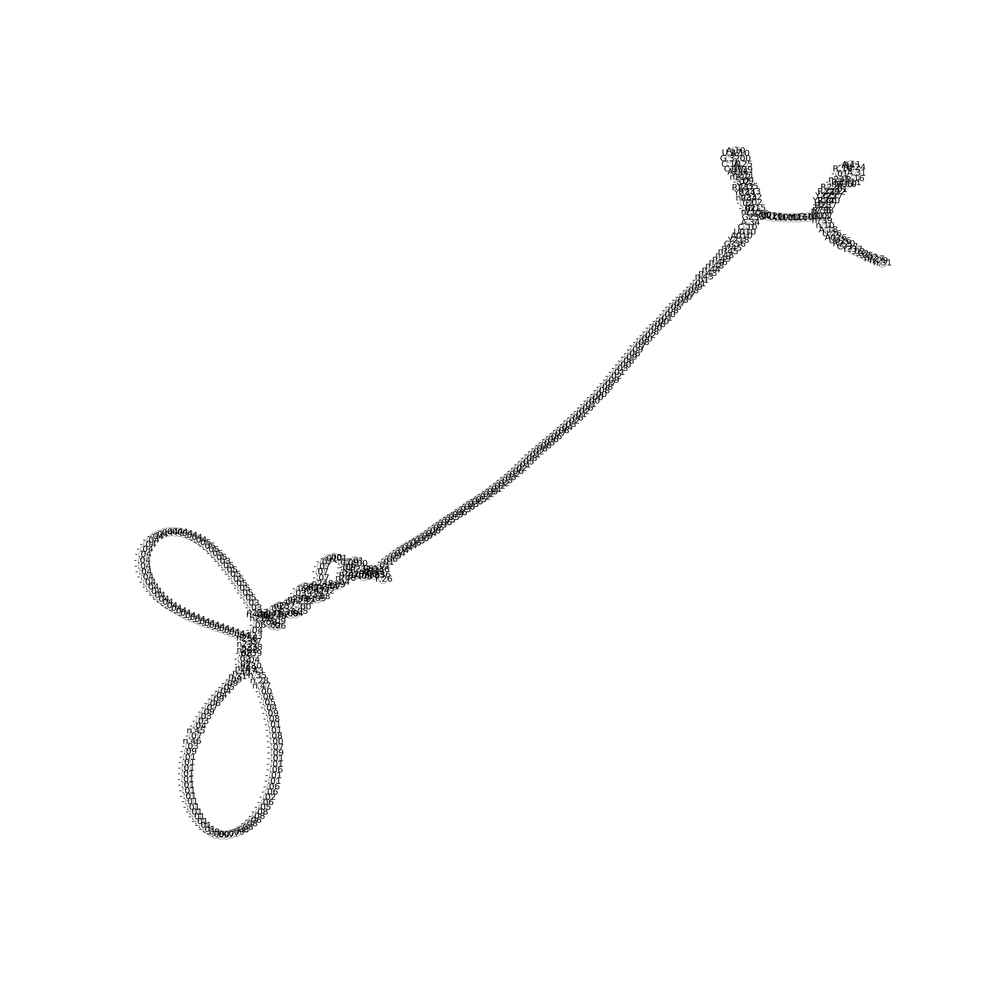

('Graph title', '550-69410-0-0')
('Graph title', '550-69410-0-0')
('Graph title', '550-69410-0-0')
('Graph title', '550-69410-0-0')


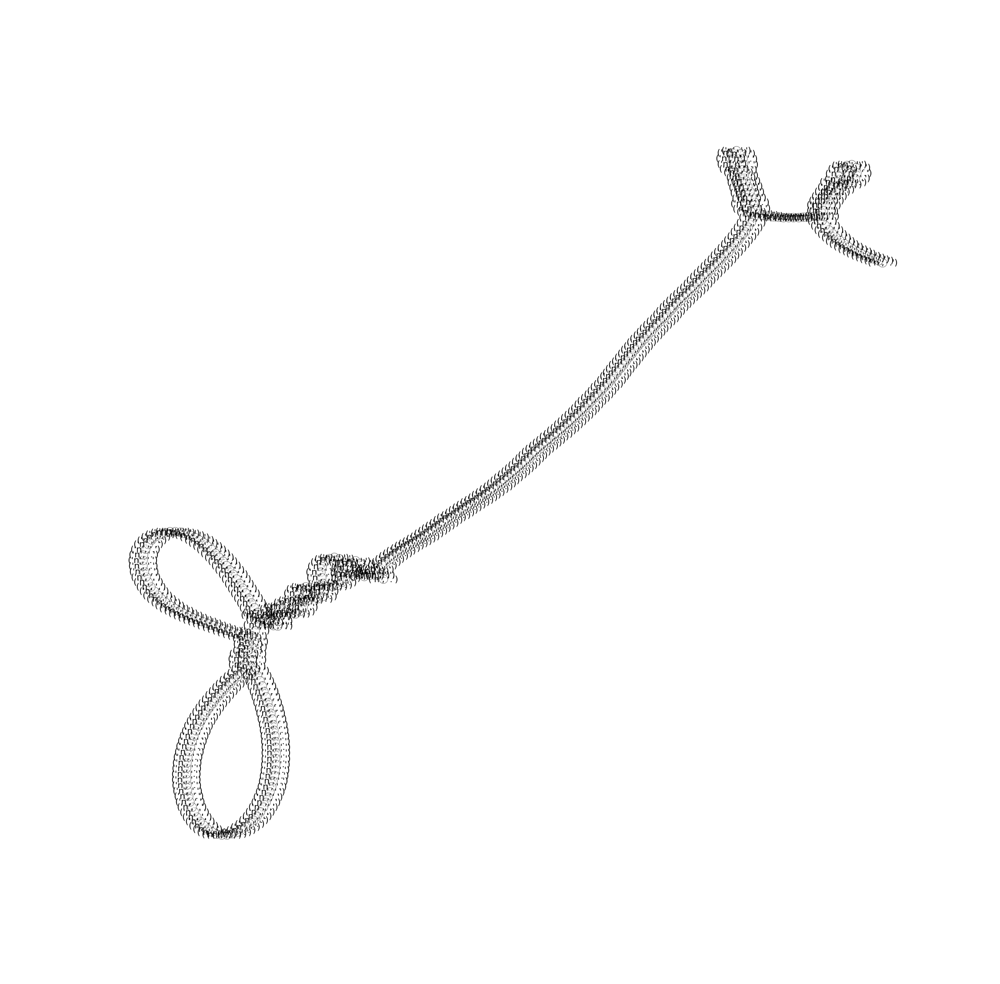

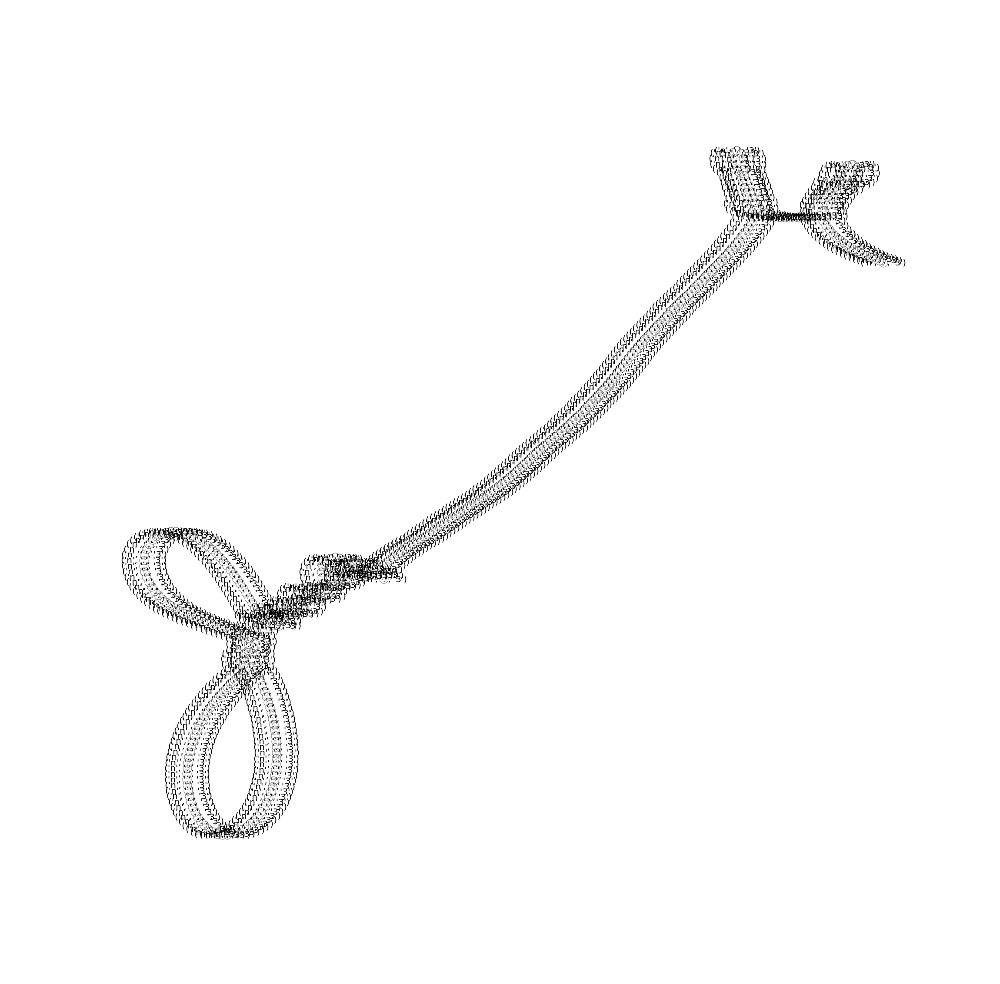

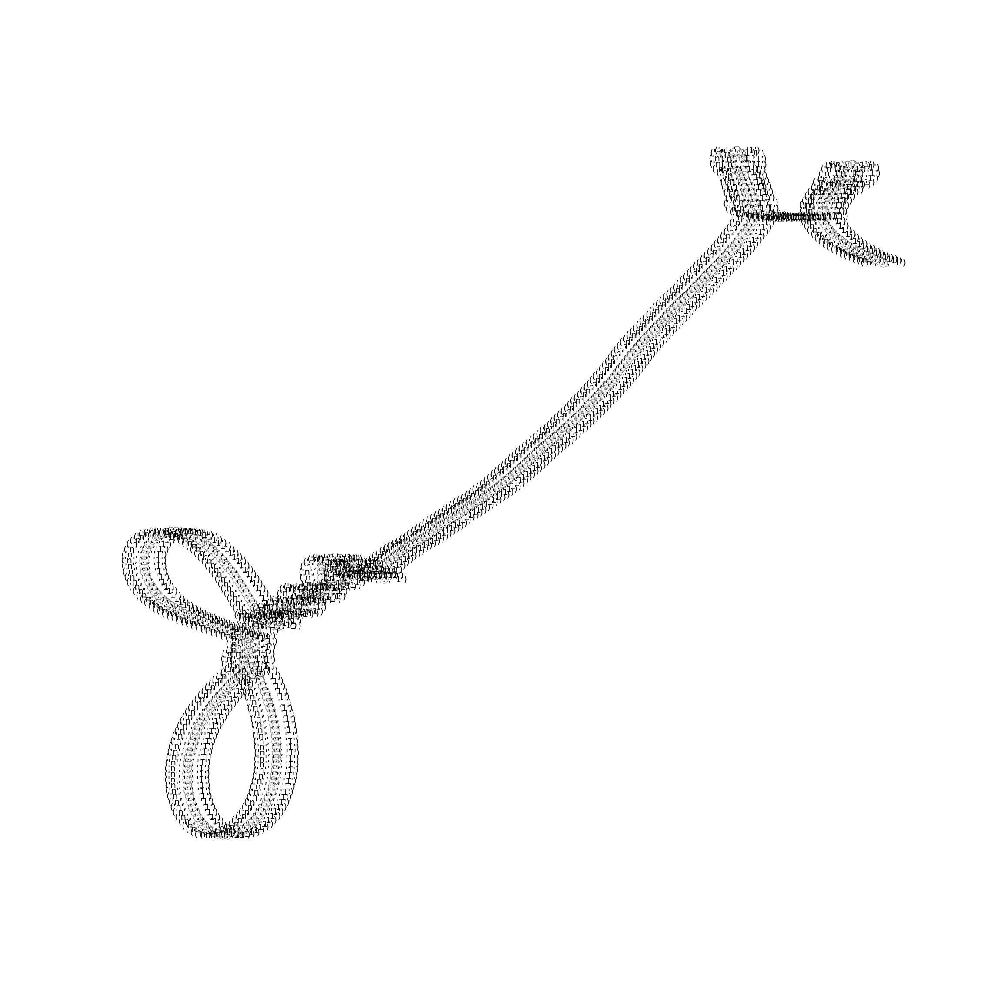

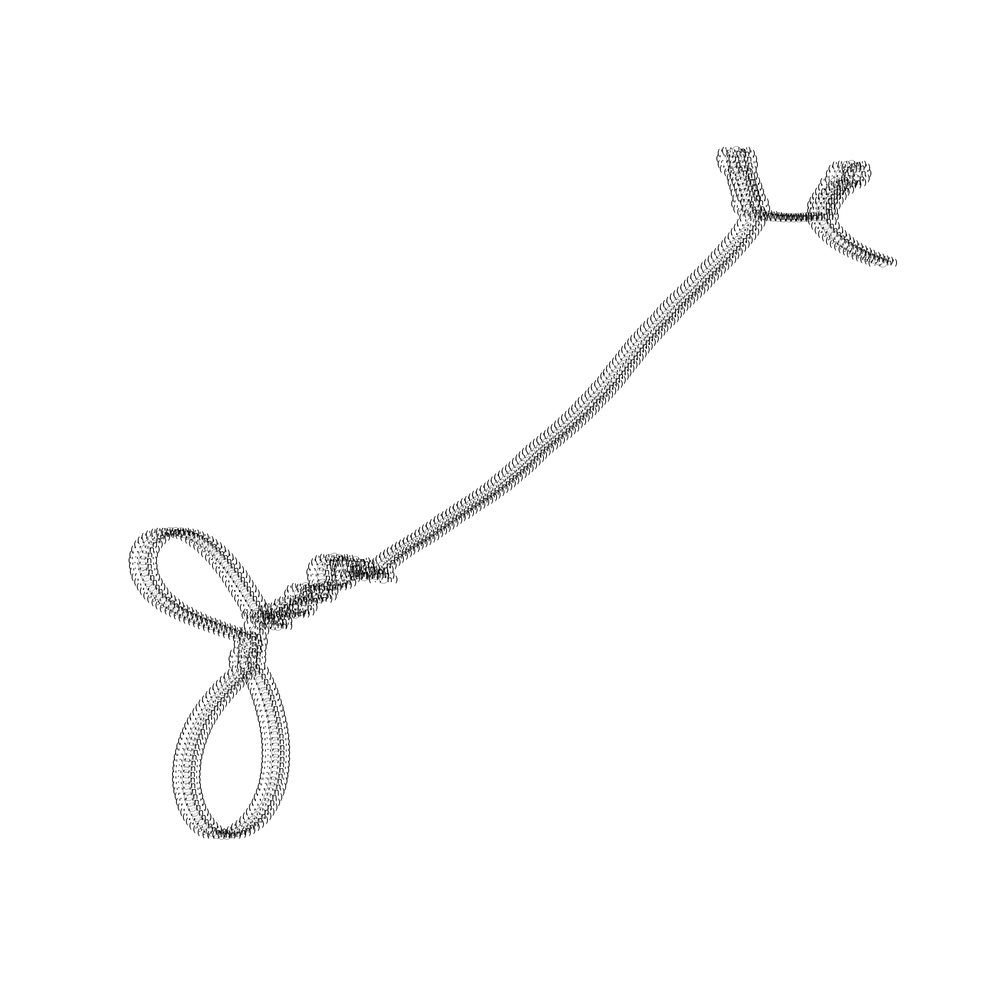

('Graph title', '550-904-1-0')


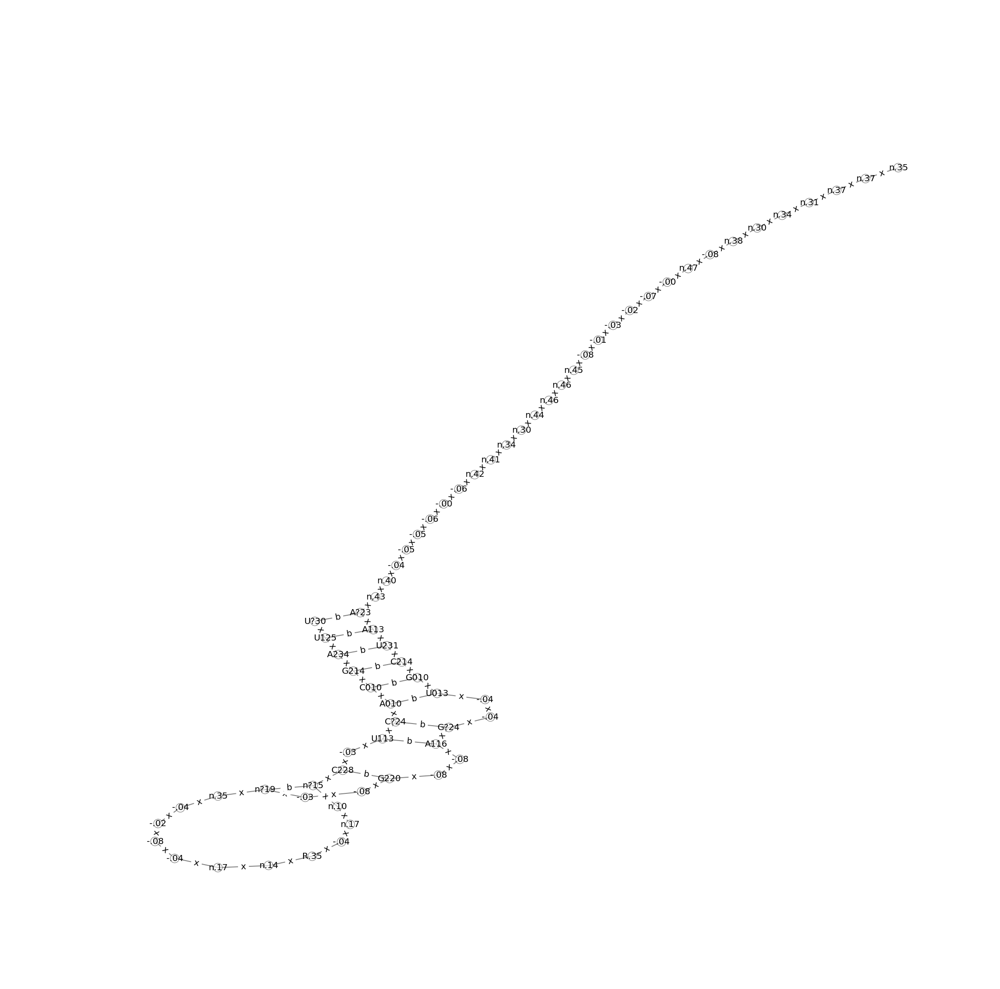

('Graph title', '550-904-1-0')
('Graph title', '550-904-1-0')
('Graph title', '550-904-1-0')
('Graph title', '550-904-1-0')


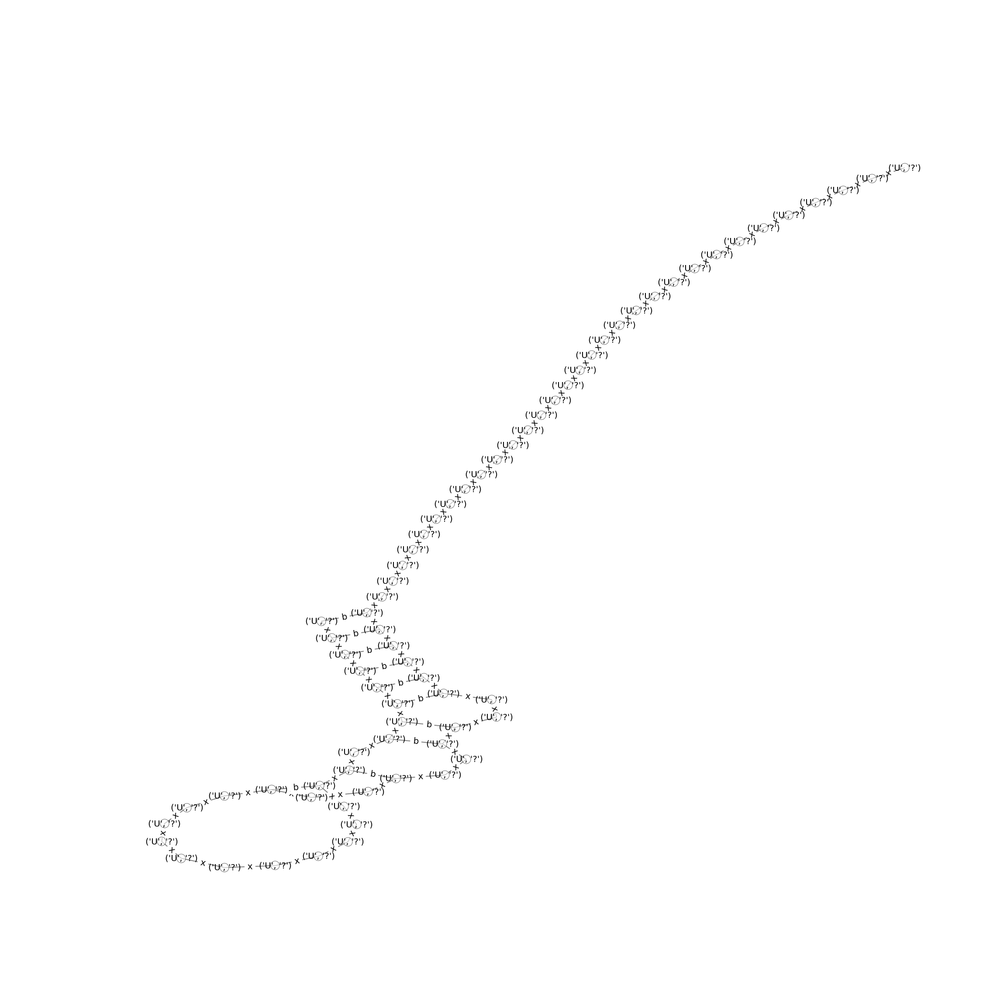

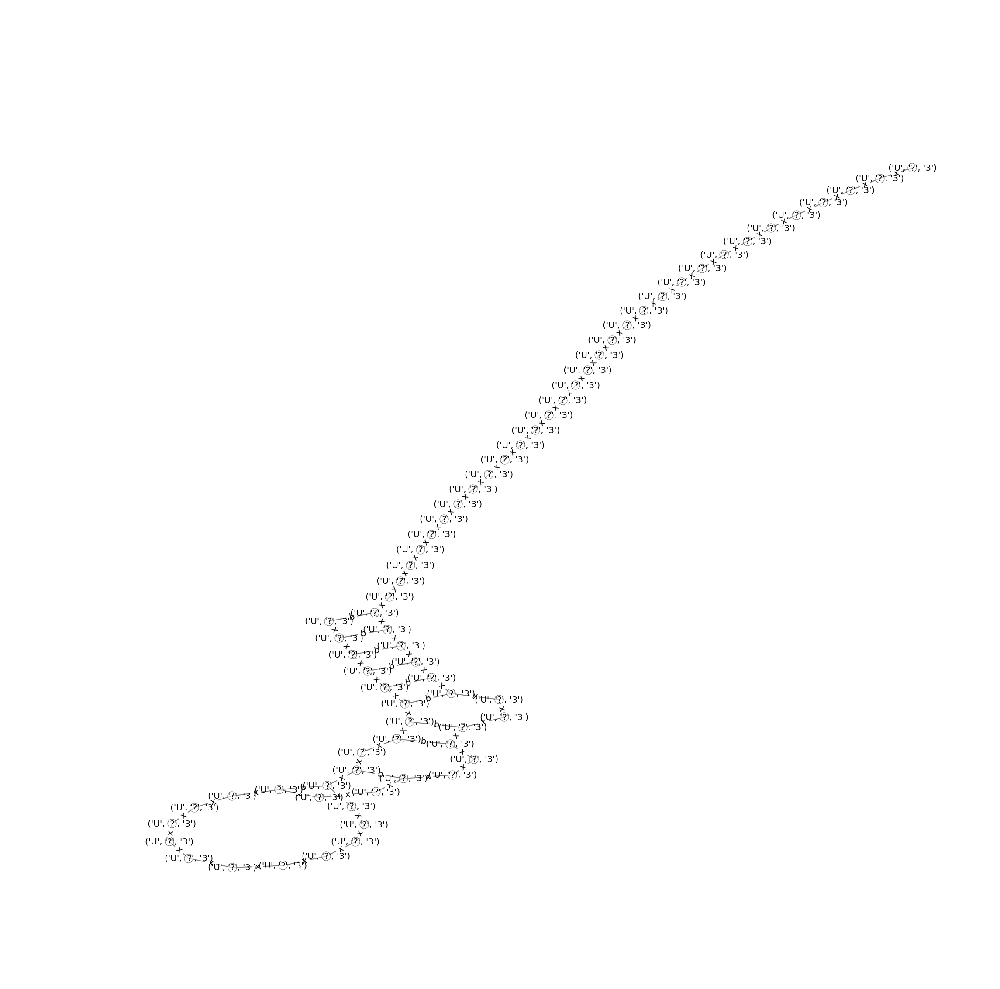

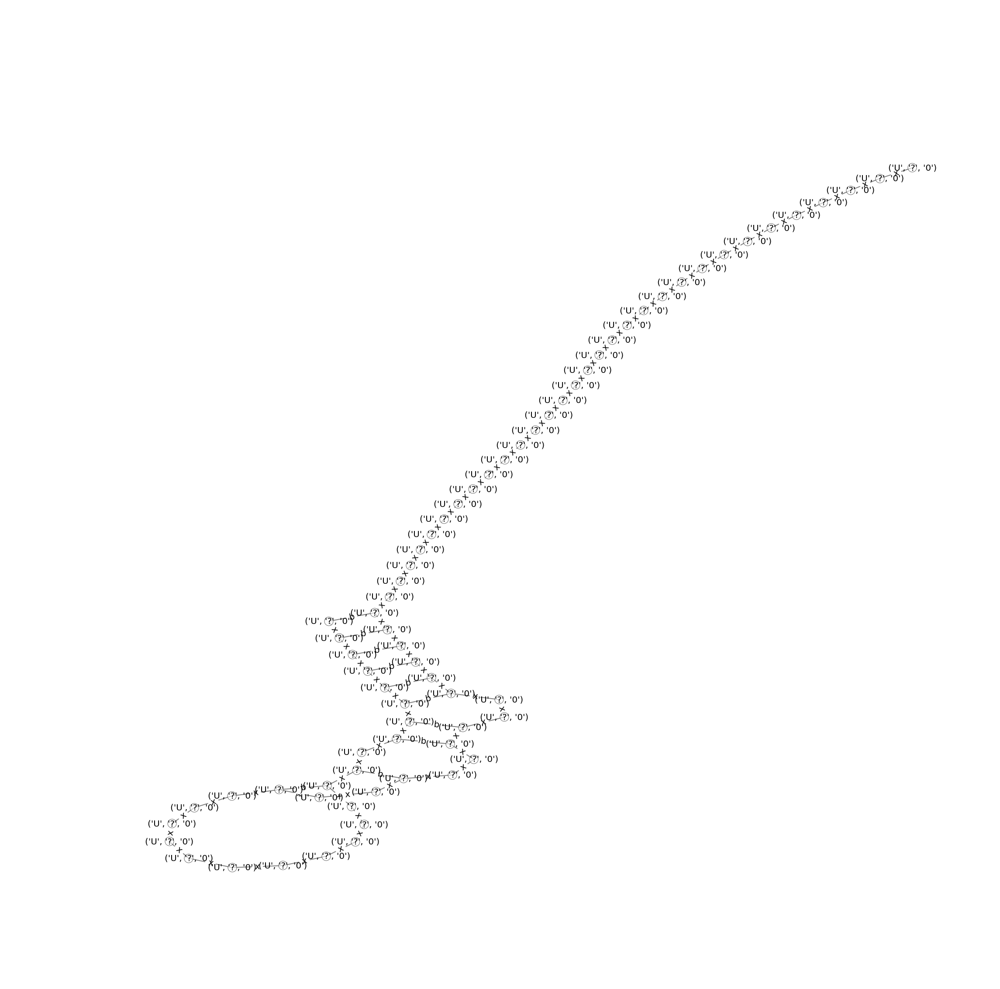

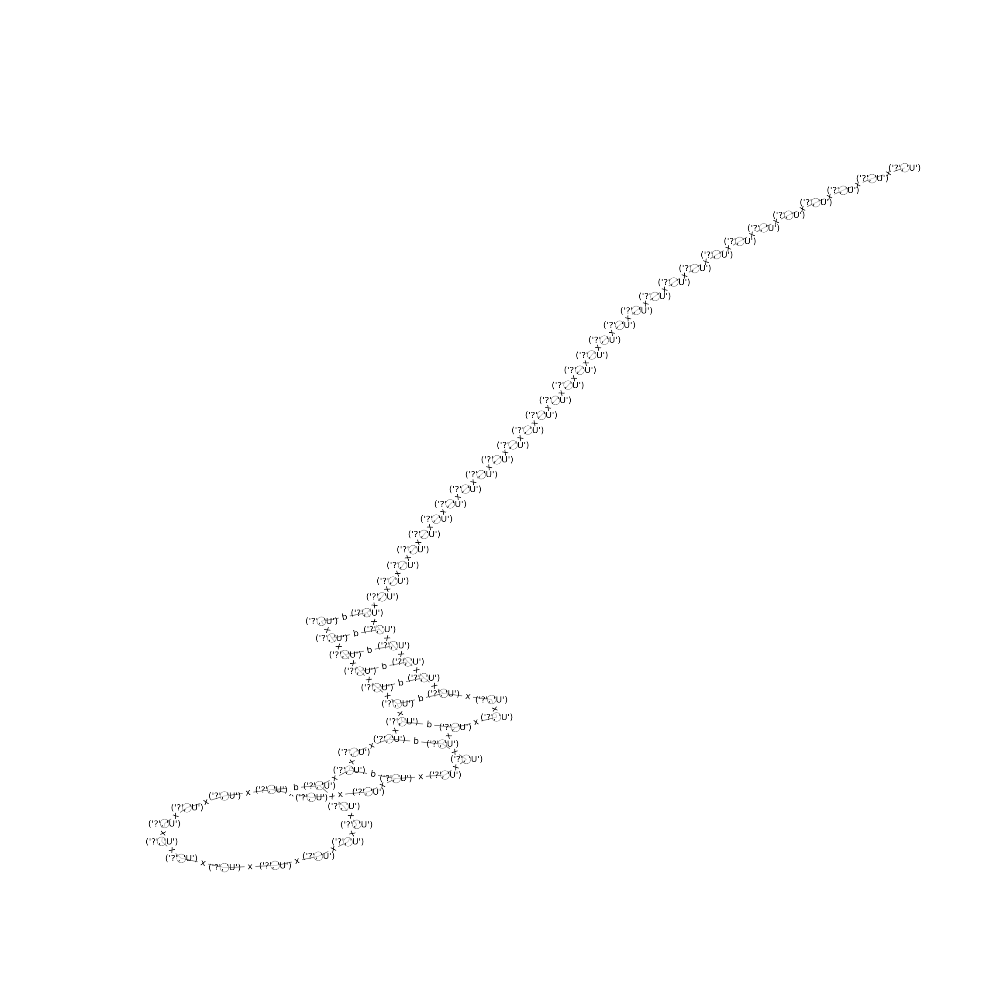

('Graph title', '550-1143-1-0')


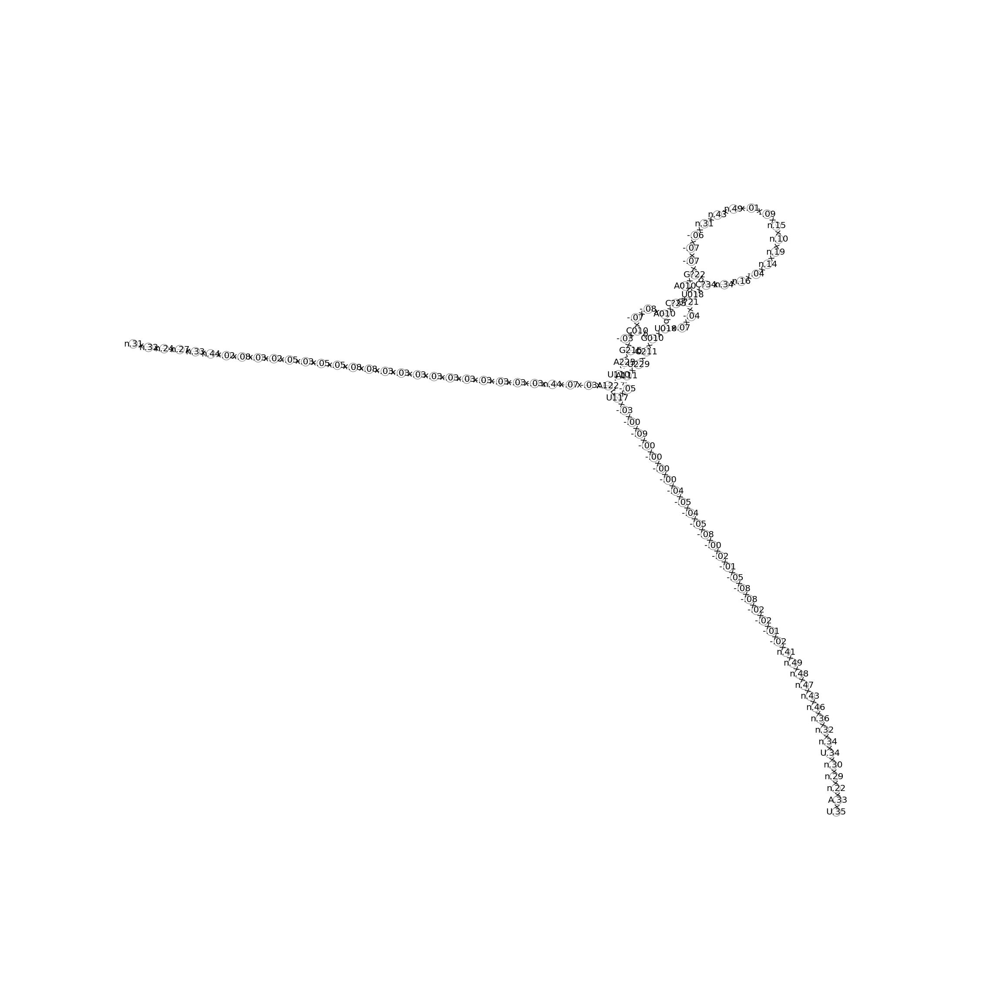

('Graph title', '550-1143-1-0')
('Graph title', '550-1143-1-0')
('Graph title', '550-1143-1-0')
('Graph title', '550-1143-1-0')


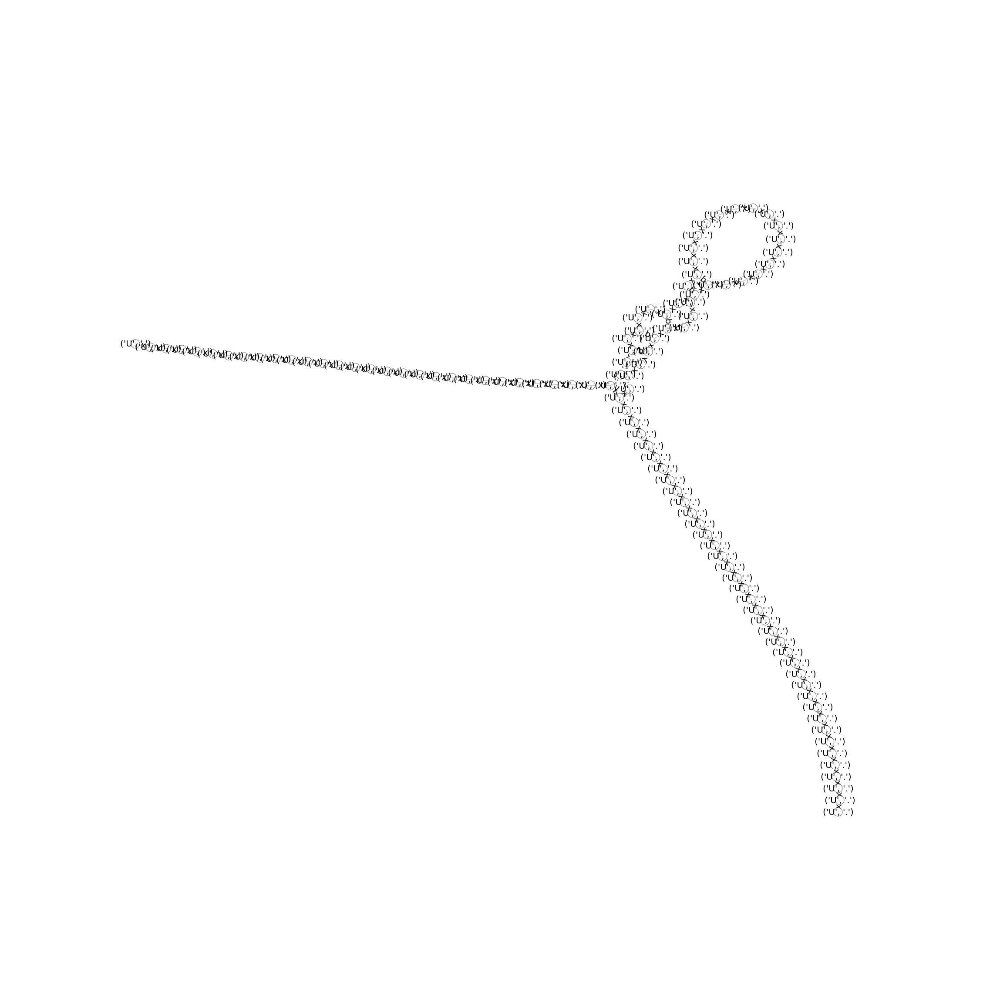

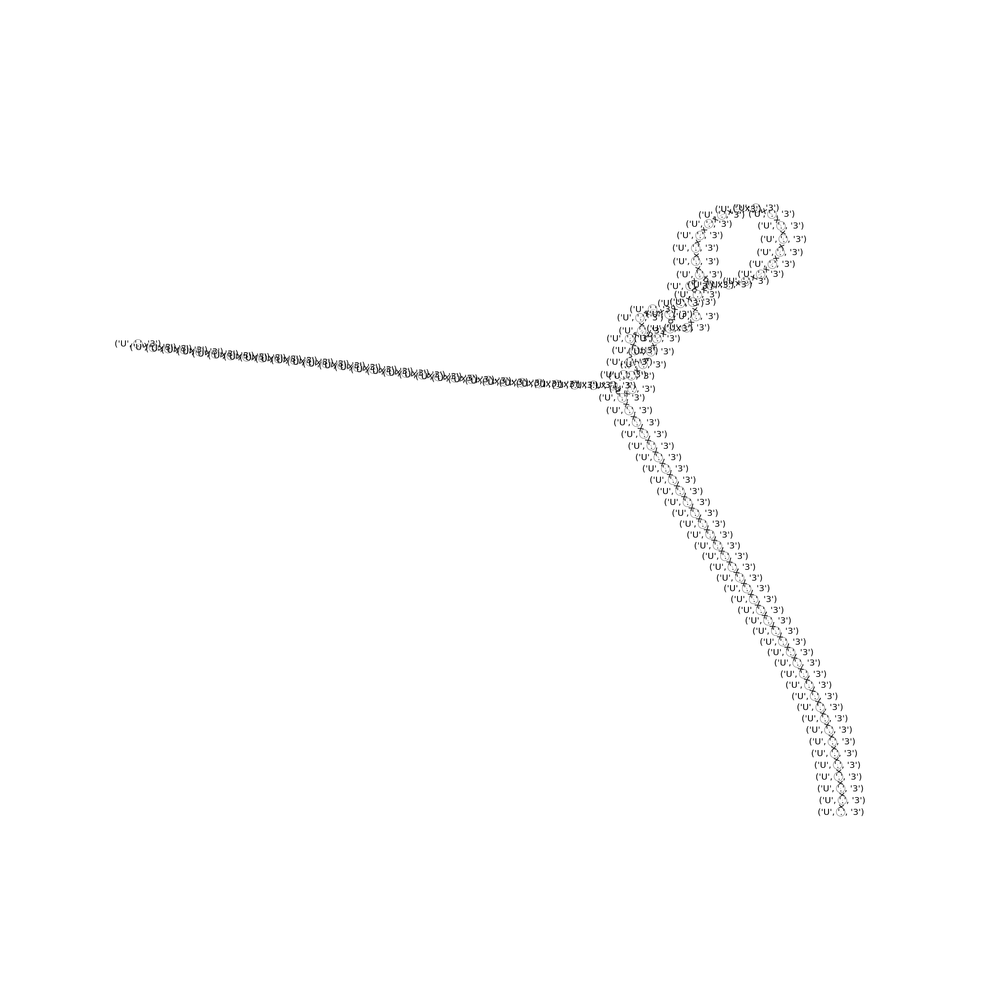

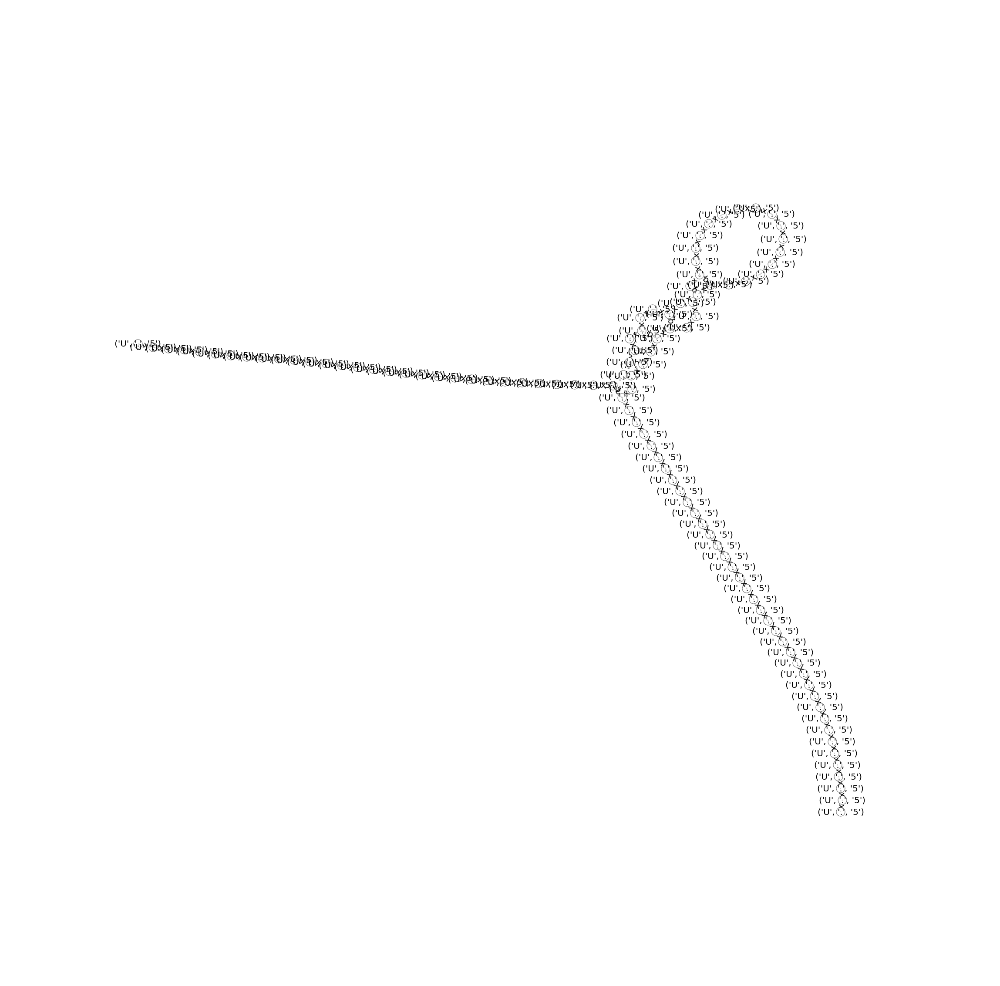

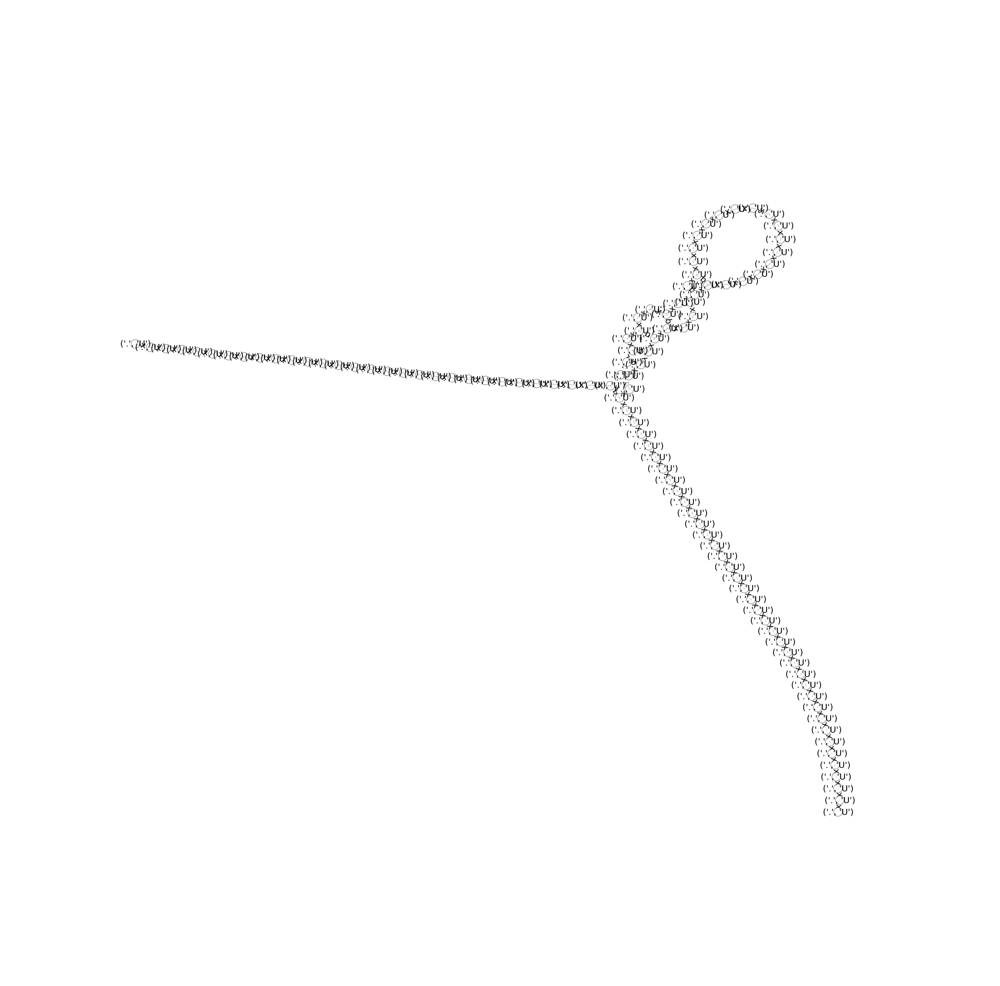

('Graph title', '550-751-0-0')


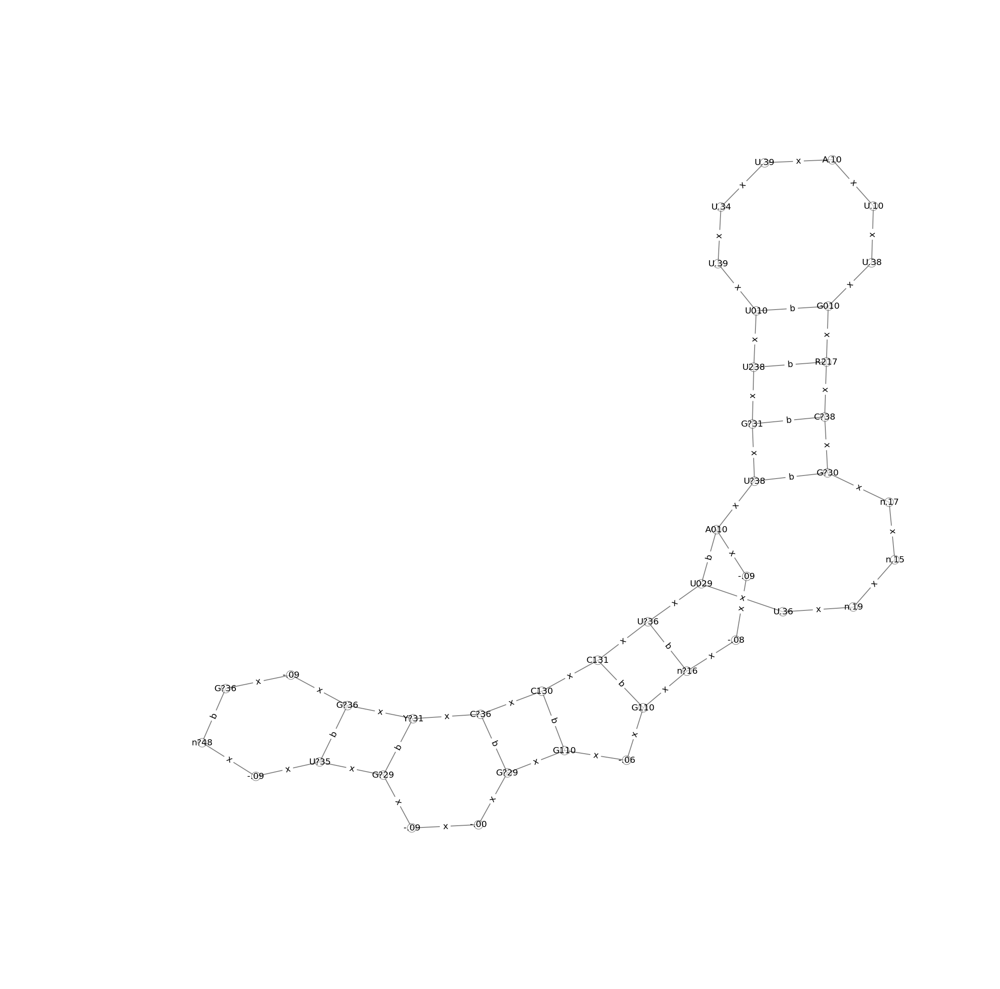

('Graph title', '550-751-0-0')
('Graph title', '550-751-0-0')
('Graph title', '550-751-0-0')
('Graph title', '550-751-0-0')


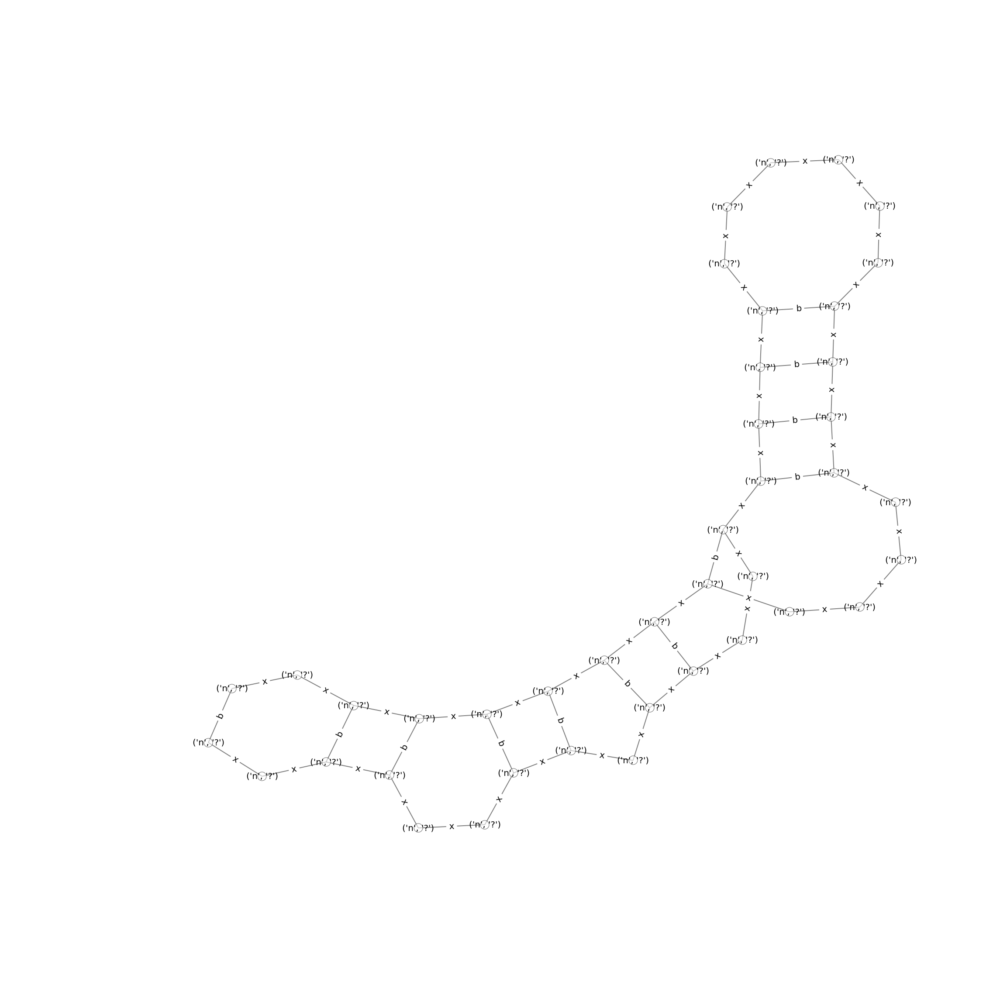

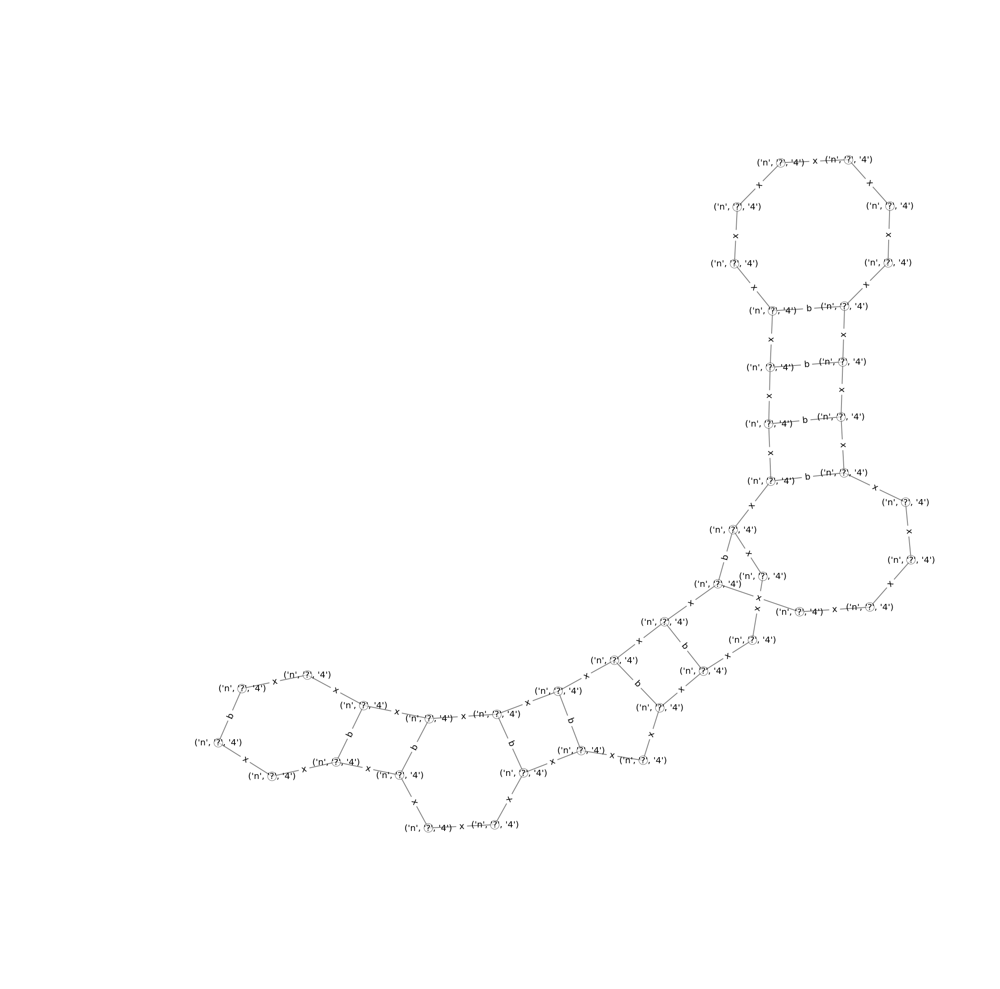

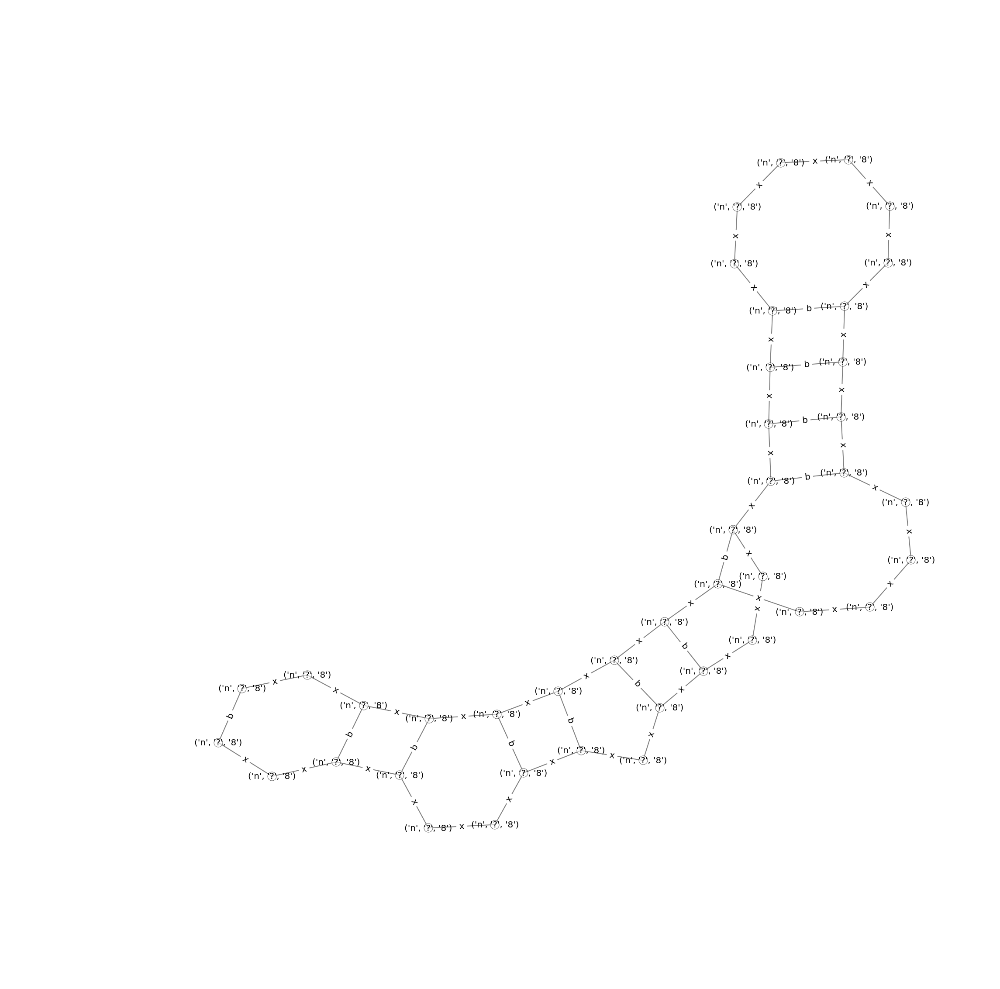

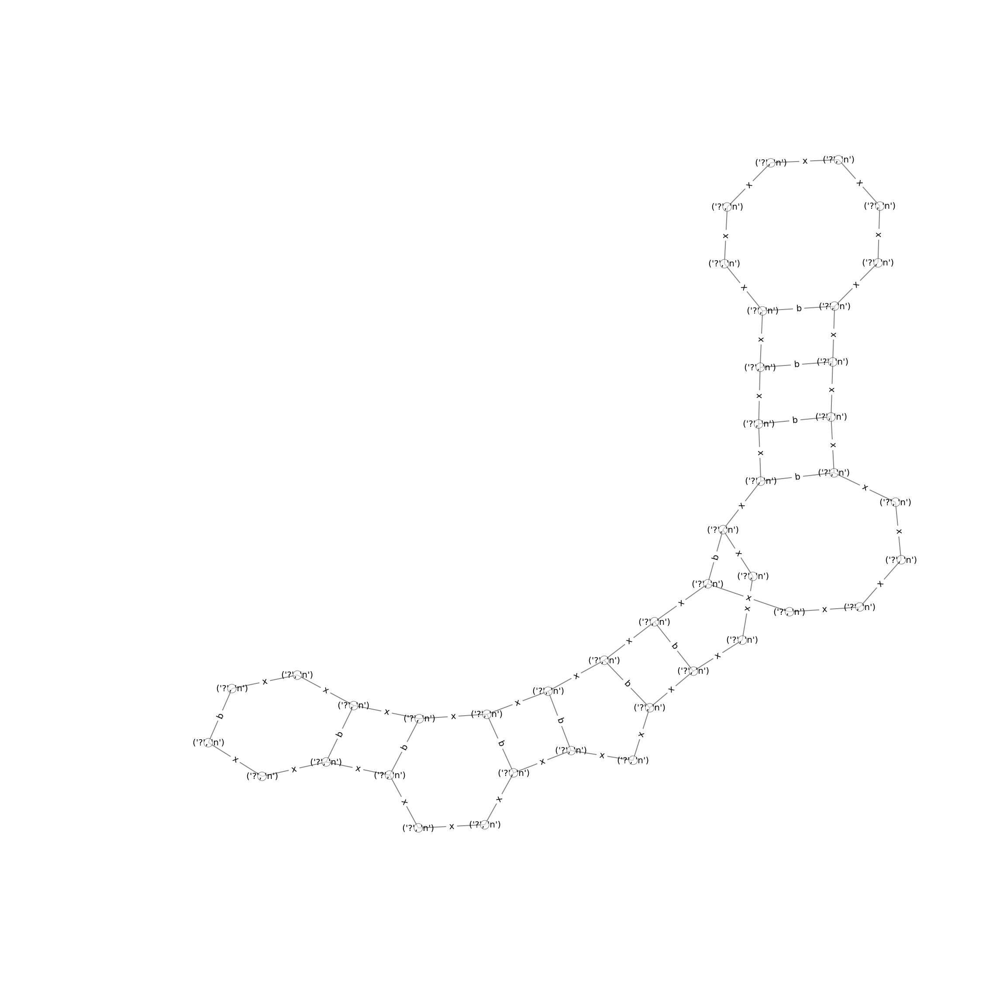

('Graph title', '550-1137-0-0')


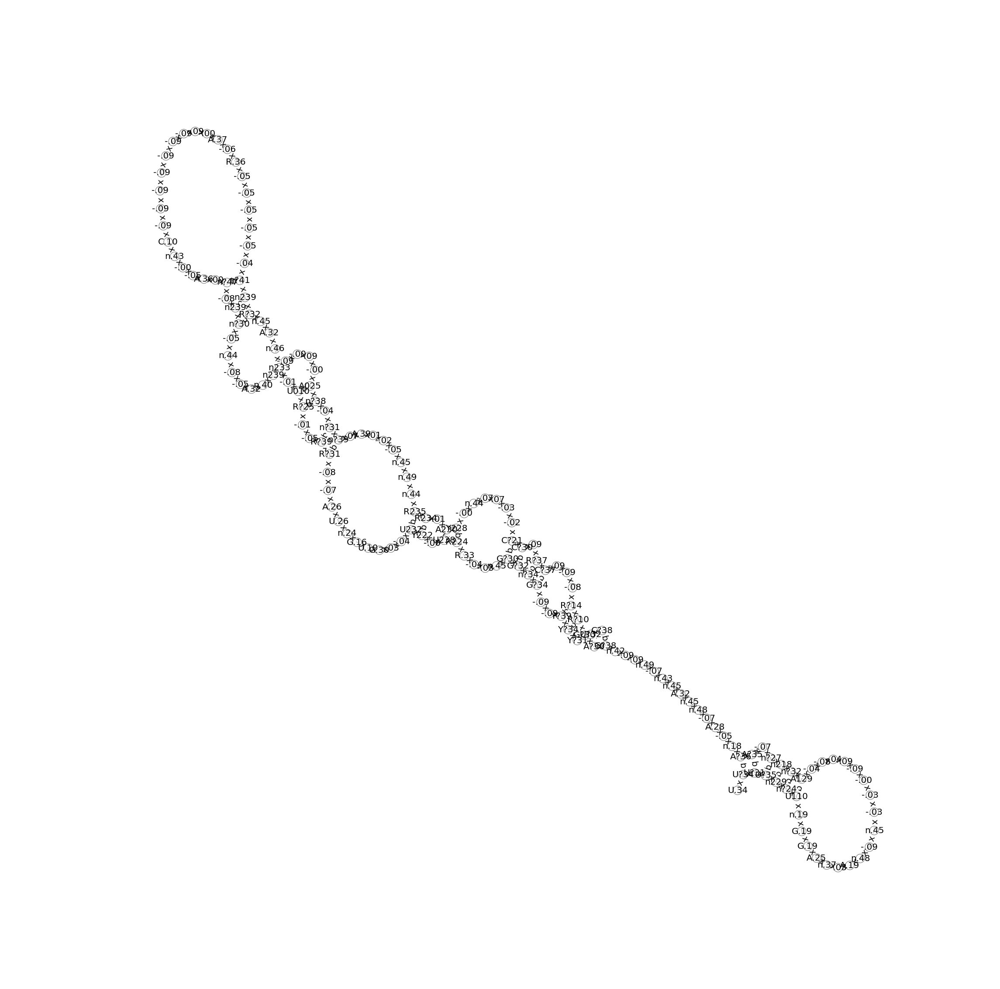

('Graph title', '550-1137-0-0')
('Graph title', '550-1137-0-0')
('Graph title', '550-1137-0-0')
('Graph title', '550-1137-0-0')


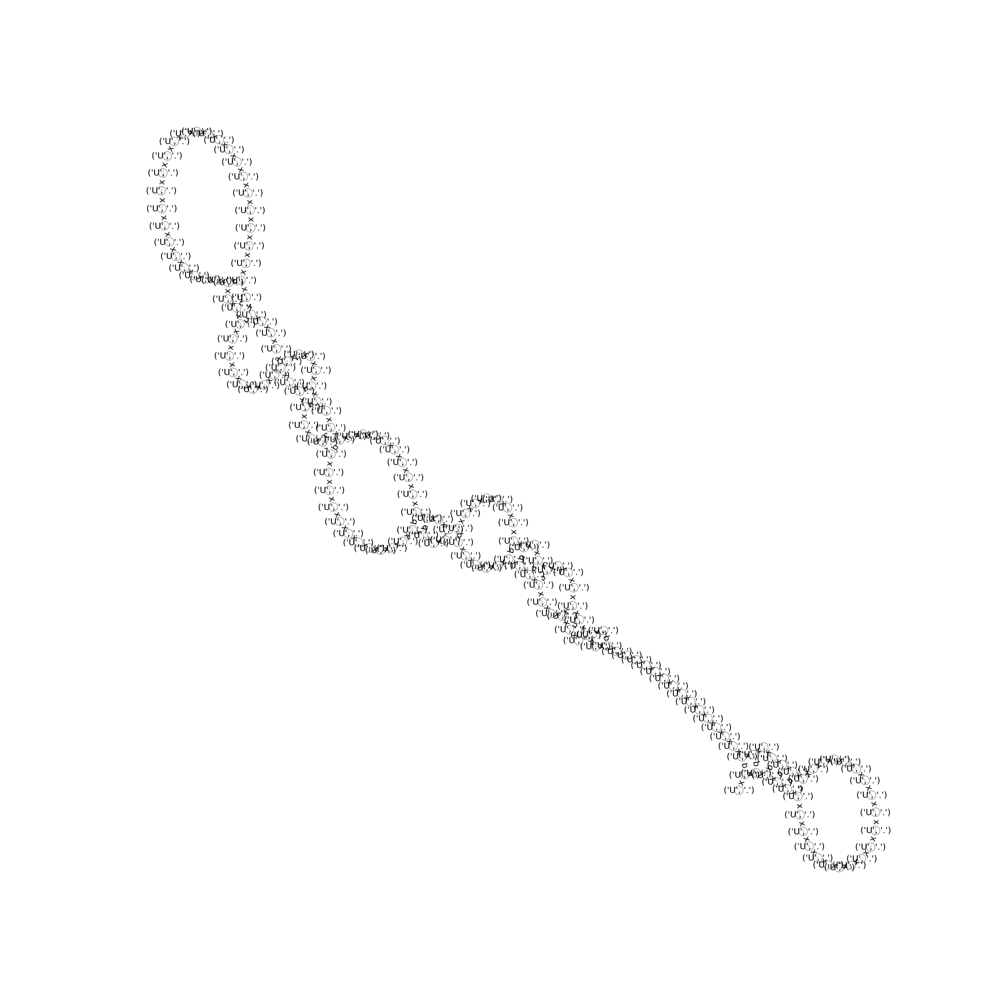

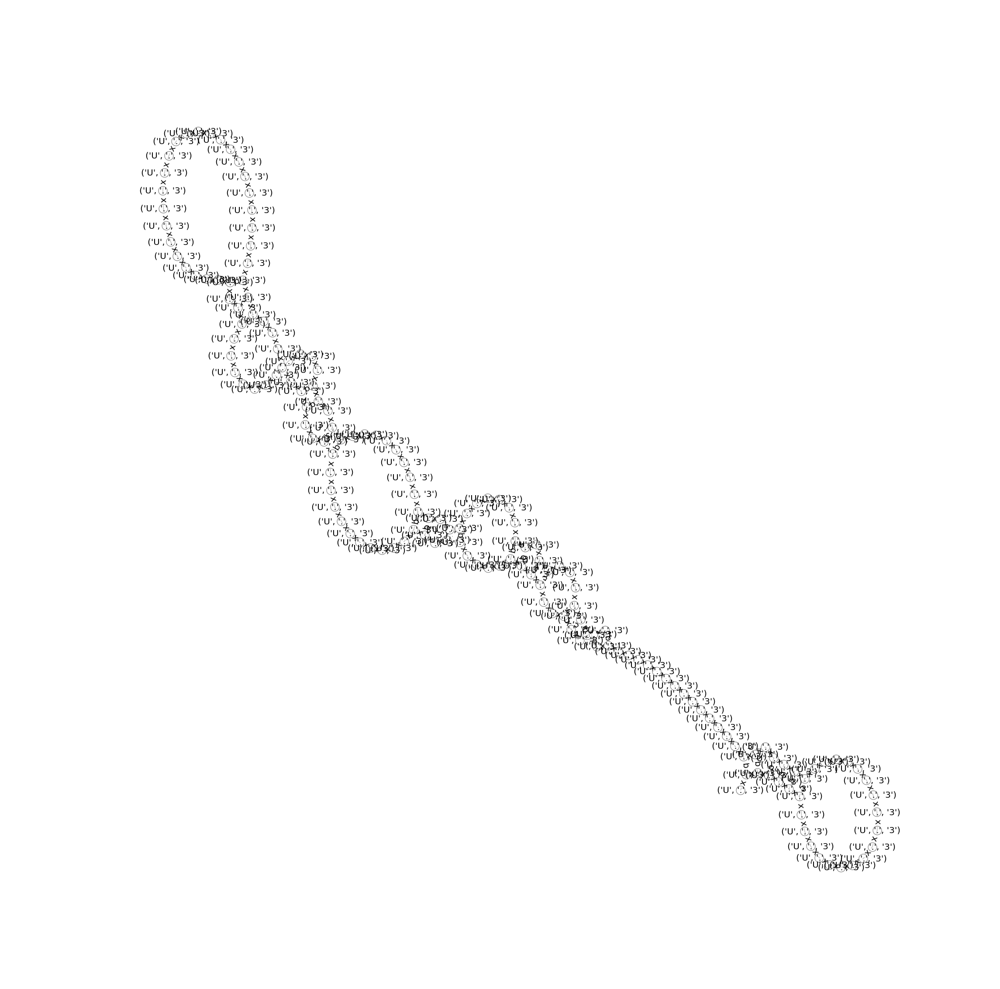

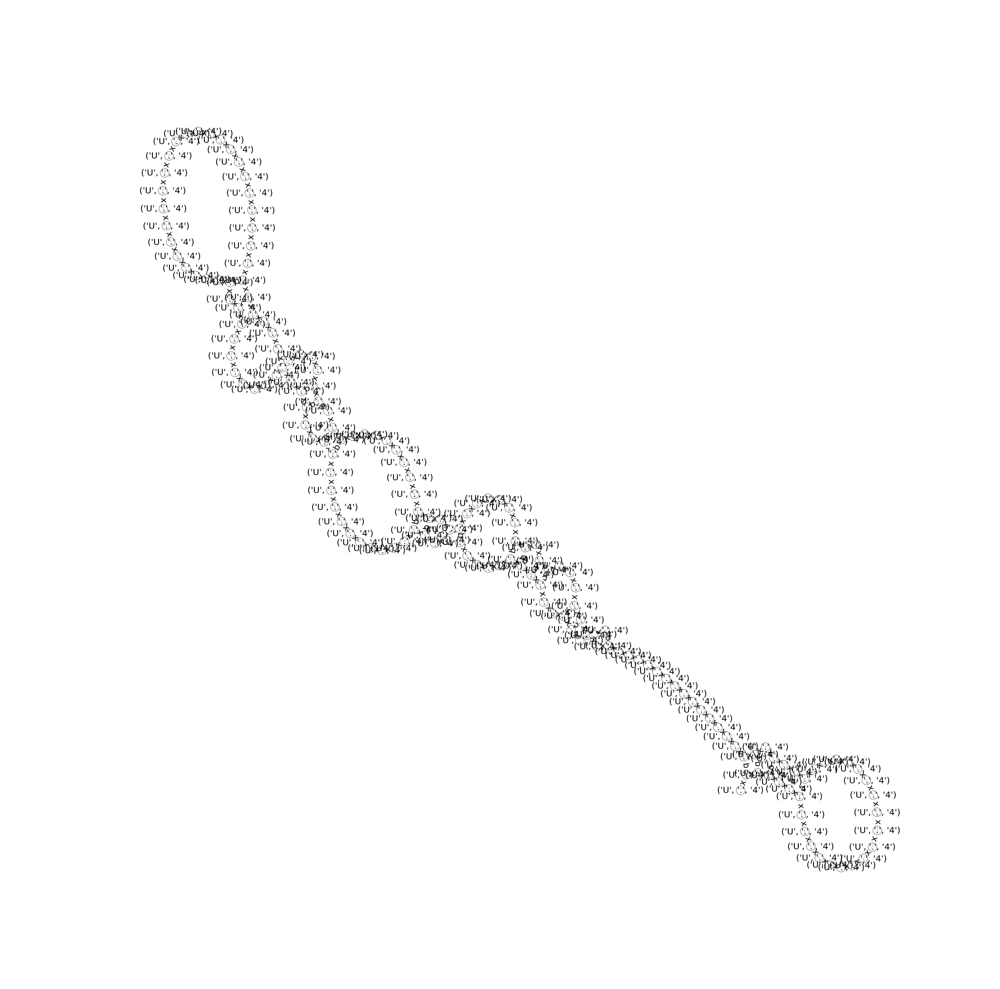

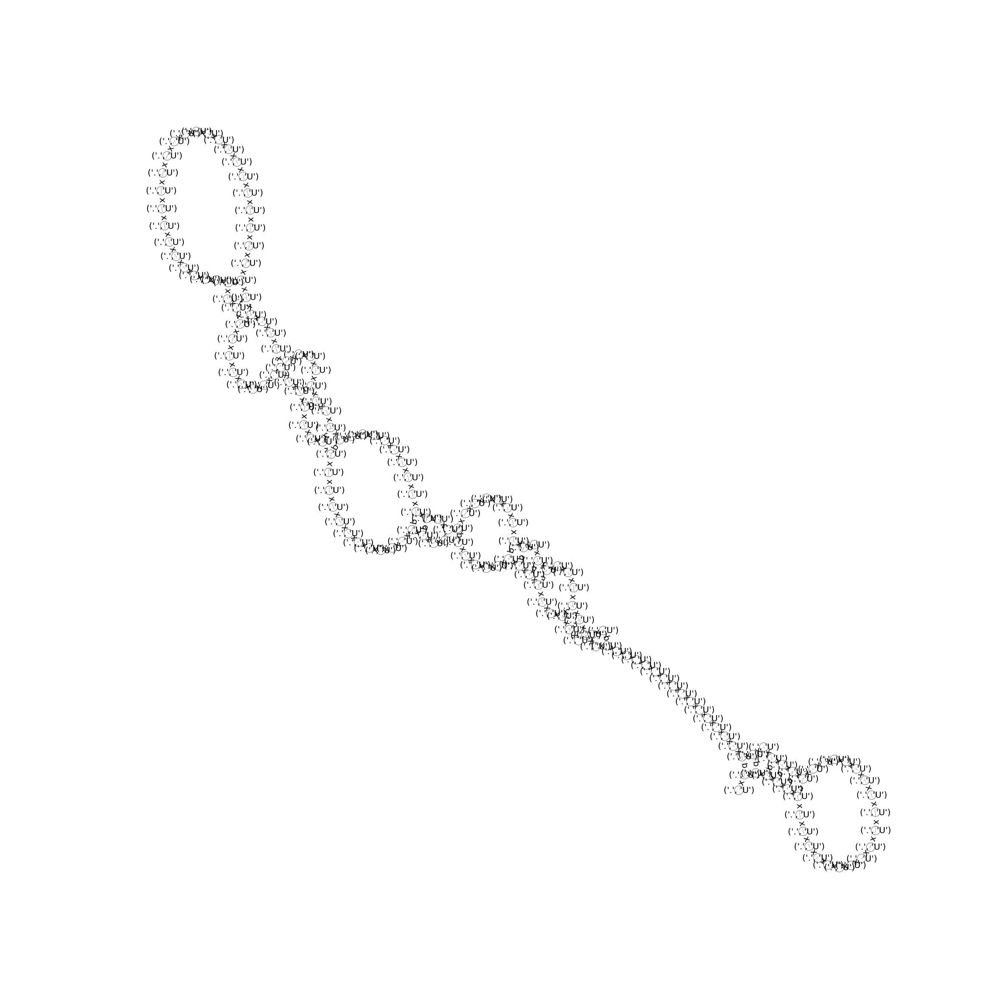

NameError: name '_createTargetFiles' is not defined

In [13]:
pos_dir = "/home/alsheikm/GitDir/EeDN_work/StoExamples/StoExmapleSmall/positives-sto"
neg_dir = "/home/alsheikm/GitDir/EeDN_work/StoExamples/StoExmapleSmall/negatives-sto"
output_dir = "/home/alsheikm/GitDir/EeDN_work/StoExamples/output"

pos_Graphs = _FolderToGraphConvertor(pos_dir)
neg_Graphs = _FolderToGraphConvertor(neg_dir)

Graph_to_targetFile = _createTargetFiles(pos_dir, neg_dir, output_dir)


## Create Target File:

generate target files

it takes the divided STO files directory and returnes a target files
with 1s for files belong to class 0, and -1 for files belong to class 1

In [94]:
def _createTargetFiles(pos_dir = None, neg_dir = None, output_dir = None):

    file_extention = '.target'
    output_file_name = 'data'
    #target_list = []
    #htmlcode = HTML.list(target_list)
    
    target_file_name = output_dir + "/" + output_file_name + file_extention

    target_file = open(target_file_name, 'w')

    for pos_file in os.listdir(pos_dir):
        target_file.write('1\n')
        #target_list.append('1')
            
    for pos_file in os.listdir(pos_dir):
        target_file.write('-1\n')
        #target_list.append('-1')
        
    target_file.close()
    #print target_list

## Divide Sto files based on its classes:

In [ ]:
'''seperate classes into diffeerent folders'''

def _classesToFolders(files_dir, partition_dir):
    pos_partition_file = "positive-partitions-test.tab"
    neg_partition_file = "negative-partitions-test.tab"

    pos_class_0_path = "/home/alsheikm/GitDir/EeDN_work/StoExamples/pos_class_0"
    pos_class_1_path = "/home/alsheikm/GitDir/EeDN_work/StoExamples/pos_class_1"
    neg_class_0_path = "/home/alsheikm/GitDir/EeDN_work/StoExamples/neg_class_0"
    neg_class_1_path = "/home/alsheikm/GitDir/EeDN_work/StoExamples/neg_class_1"
    


    tab_list = os.listdir(partition_dir)
    for tab_file in os.listdir(partition_dir):
        files_list = os.listdir(files_dir)
        
        for folder_name in os.listdir(files_dir):
            folder_path = os.path.join(files_dir, folder_name)
            
            if tab_file == pos_partition_file and folder_name == 'positives-sto':
                read_pos_tab = open(os.path.join(partition_dir, tab_file), 'r')

                for line in read_pos_tab:
                    line_parts= line.split()
                    file_name = line_parts[0]
                    file_class_num = line_parts[1]

                    '''copy file to the pos_class_0 folder'''
                    if file_class_num == '0':
                        for file in os.listdir(folder_path):
                            file_path = os.path.join(folder_path, file)
                            file = ntpath.splitext( ntpath.basename(file_path))[0]
                            if fnmatch.fnmatch(file, file_name):
                                shutil.copy(file_path, pos_class_0_path)
                            
                    '''copy file to the pos_class_1 folder'''
                    if file_class_num == '1':                      
                        for file in os.listdir(folder_path):
                            file_path = os.path.join(folder_path, file)
                            file = ntpath.splitext( ntpath.basename(file_path))[0]
                            if fnmatch.fnmatch(file, file_name):
                                shutil.copy(file_path, pos_class_1_path)
                                
            if tab_file == neg_partition_file and folder_name == 'negatives-sto':
                read_neg_tab = open(os.path.join(partition_dir, tab_file), 'r')
                for line in read_neg_tab:
                    line_parts= line.split()
                    file_name = line_parts[0]
                    file_class_num = line_parts[1]
                    '''copy file to the pos_class_0 folder'''
                    if file_class_num == '0':
                        for file in os.listdir(folder_path):
                            file_path = os.path.join(folder_path, file)
                            file = ntpath.splitext( ntpath.basename(file_path))[0]
                            if fnmatch.fnmatch(file, file_name):
                                shutil.copy(file_path, neg_class_0_path)

                        '''copy file to the pos_class_1 folder'''
                    if file_class_num == '1':
                        for file in os.listdir(folder_path):
                            file_path = os.path.join(folder_path, file)
                            file = ntpath.splitext( ntpath.basename(file_path))[0]
                            if fnmatch.fnmatch(file, file_name):
                                shutil.copy(file_path, neg_class_1_path)

In [ ]:
files_dir = "/home/alsheikm/GitDir/EeDN_work/StoExamples/StoExmapleSmall"
partition_dir = "/home/alsheikm/GitDir/EeDN_work/StoExamples/partitionsFiles"

Class_to_folder = _classesToFolders(files_dir, partition_dir)